In [28]:
import os
import sys
sys.path.append('/mnt/mnt/5TB_slot2/Tobias')
sys.path.append('/mnt/mnt/5TB_slot2/Tobias/TobiasPy/fastMRI')
sys.path.append('/mnt/mnt/4TB_pcie/fastBrain/')
import h5py
import numpy as np
import numpy.fft as nf
import matplotlib.pyplot as plt
import torch
from torch.utils.data import DataLoader
from models.unet.unet_model import UnetModel as UnetModel
from FF_net import FF_net
from FF_net import FF_simple_net
from FF_net import FF_net_tanh
from FF_net import Complex_net
import argparse
from common.args import Args
import models.unet.run_unet  as Run
import torch.nn as nn
import logging
import pathlib
from pathlib import Path
import random
from torch.utils.data import Dataset
import time
from torch.nn import functional as F
import shutil
from tensorboardX import SummaryWriter
import torchvision
from torchvision import transforms, utils
import net_utils as nu
import calendar
import datetime
from longOne import ComplexFourier,ComplexEndToEnd
from complex_unet_model import ComplexUnetModel
from complex_end_to_end import ComplexEndToEnd, td_fourier_net, td_fourier_net_real

import sigpy as sp
import sigpy.plot as pl
from skimage.metrics import structural_similarity as np_ssim
import vd_spiral

from FF_net import Complex_net_ext

%load_ext autoreload
%reload_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [4]:
sys.argv=['']
def create_arg_parser():
    timestamp = calendar.timegm(time.gmtime())
    human_readable = datetime.datetime.fromtimestamp(timestamp).isoformat()
    #human_readable="pure_inverse_fourier"
    human_readable="ComplexEndToEnd_Kspace_FourierTransform_Compare-Complex"
    parser = argparse.ArgumentParser(description="ML parameters")
    parser.add_argument('--num-pools', type=int, default=4, help='Number of U-Net pooling layers')
    parser.add_argument('--drop-prob', type=float, default=0.0, help='Dropout probability')
    parser.add_argument('--num-chans', type=int, default=32, help='Number of U-Net channels')

    parser.add_argument('--batch-size', default=8, type=int, help='Mini batch size')
    parser.add_argument('--num-epochs', type=int, default=250, help='Number of training epochs')
    parser.add_argument('--lr', type=float, default=0.0001, help='Learning rate')
    parser.add_argument('--lr-step-size', type=int, default=100,
                        help='Period of learning rate decay')
    parser.add_argument('--lr-gamma', type=float, default=0.1,
                        help='Multiplicative factor of learning rate decay')
    parser.add_argument('--weight-decay', type=float, default=0.01,
                        help='Strength of weight decay regularization')
    parser.add_argument('--momentum', type=float, default=0.1,
                        help='Strength of optimizer momentum')

    parser.add_argument('--report-interval', type=int, default=10000, help='Period of loss reporting')
    parser.add_argument('--data-parallel', default=True,
                        help='If set, use multiple GPUs using data parallelism')
    parser.add_argument('--device', type=str, default='cuda',
                        help='Which device to train on. Set to "cuda" to use the GPU')
    parser.add_argument('--exp-dir', type=pathlib.Path, default='/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_'+str(human_readable),
                        help='Path where model and results should be saved')
    parser.add_argument('--resume', action='store_true', default=False,
                        help='If set, resume the training from a previous model checkpoint. '
                             '"--checkpoint" should be set with this')
    parser.add_argument('--checkpoint', type=str, default='/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_'+str(human_readable)+'/best_model.pt',
                        help='Path to an existing checkpoint. Used along with "--resume"')
    parser.add_argument('--logdir', type=str, default='/mnt/mnt/5TB_slot2/Tobias/Thesis/log/ff_lrelu_'+str(human_readable),
                        help='Path to an existing checkpoint. Used along with "--resume"')
    parser.add_argument('--seed', default=42, type=int, help='Seed for random number generators')
    parser.add_argument('--resolution', default=128, type=int, help='Resolution of images')
    parser.add_argument('--device_ids', default=[2,3] , help='GPUS used')
    return parser
args=create_arg_parser().parse_args()
print("save to",args.checkpoint)

save to /mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_ComplexEndToEnd_Kspace_FourierTransform_Compare-Complex/best_model.pt


In [5]:
def test_fourier():
    sig = np.random.randn(args.resolution) + 1j*np.random.randn(320)
    F = np.fft.ifft(sig, axis=-1)
    # First half of inputs/outputs is real part, second half is imaginary part
    X = torch.from_numpy(np.hstack([sig.real, sig.imag])).double()
    Y = torch.from_numpy((F.real**2+F.imag**2)**(1/2)).double()
    return X,Y

class SliceData(Dataset):
    """
    A PyTorch Dataset that provides access to MR image slices.
    """
    
    def __init__(self, root="/mnt/mnt/5TB_slot2/fastMRI/multicoil_train", sample_rate=1.):
        self.examples = []
        #potential to apply pre-process transform
        files = list(pathlib.Path(root).iterdir())
        if sample_rate < 1:
            #random.shuffle(files)
            num_files = round(len(files) * sample_rate)
            files = files[:num_files]
        for fname in sorted(files):
            print(fname)
            try:
                #print(h5py.File(fname, 'r').keys())
                #maybe also only randomly select parts of slices. Otherwise lot of outer noise-like structures.
                xml = h5py.File(fname, 'r')['ismrmrd_header']
                kspace = h5py.File(fname, 'r')['kspace']
                num_slices = kspace.shape[0]
                num_channels=kspace.shape[1]
                if (kspace.shape[-2]<args.resolution) or (kspace.shape[-1]<args.resolution):# or num_channels!=16:
                    continue
                print(len(self.examples))
                for slice in range(num_slices):
                    crop_size = (min(args.resolution, kspace.shape[-2]),min(args.resolution, kspace.shape[-1]))
                    k=nu.center_crop(kspace[slice], crop_size)[0]
                    target=abs(nu.make_ift(k))
                    m=np.max(target)
                    if m>0:
                        target/=m
                    else:
                        continue
                    k=nu.to_tensor(k).unsqueeze(0)
                    #us=nu.apply_mask(k,r=3)[0]#*args.resolution no undersampling for now
                    us=k
                    us/=m
                    if np.isnan(np.sum(target)):
                        continue
                    X=us#.flatten()
                    print(X.shape)
                    #print(X.shape)
                    Y=nu.to_tensor(target)
                    #print(Y.shape)
                    #X,Y=test_fourier()
                    self.examples += [(fname, slice, X, Y)]
            except:
                print("Couldn't open file")
    
    def __len__(self):
        return len(self.examples)
    
    def __getitem__(self, i):
        fname, slice, f, t = self.examples[i]
#         with h5py.File(fname, 'r') as data:
#             full=to_tensor(data['kspace'][slice])
#             crop_size = (min(args.resolution, full.shape[-3]),min(args.resolution, full.shape[-2]))          
#             full=complex_center_crop(full,crop_size)
            
#             kspace = to_tensor(data['kspace'][slice])
#             crop_size = (min(args.resolution, kspace.shape[-3]), min(args.resolution, kspace.shape[-2]))
#             kspace=apply_mask(kspace)[0]
#             kspace = complex_center_crop(kspace, crop_size)
            
        return (f, t)

In [6]:
def create_data_loaders():
    #batch_size=32
    #mask_func = None
    #if args.mask_kspace:
    #    mask_func = MaskFunc(args.center_fractions, args.accelerations)
    train_data = SliceData(root="/mnt/mnt/4TB_pcie/fastBrain/multicoil_train",sample_rate=0.25)
    dev_data = SliceData(root="/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain",sample_rate=0.25)
    test_data = SliceData(root="/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain",sample_rate=0.05)
    train_loader = DataLoader(
        dataset=train_data,
        batch_size=args.batch_size,
        shuffle=True,
        num_workers=0,
        pin_memory=True,
    )
    dev_loader = DataLoader(
        dataset=dev_data,
        batch_size=args.batch_size,
        shuffle=True,
        num_workers=0,
        pin_memory=True,
    )
    test_loader=None
#     test_loader = DataLoader(
#         dataset=test_data,
#         num_workers=0,
#         pin_memory=True,
#     )
    return train_loader, dev_loader, test_loader

In [7]:
t=time.time()
train_loader, dev_loader, test_loader= create_data_loaders()
print("Time taken to load data: ",time.time()-t)

/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_200_6002442.h5
0
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_200_6002466.h5
16
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2]

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6002917.h5
256
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128,

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6003008.h5
494
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6003009.h5
510
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128,

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_202_6000563.h5
746
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/f

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_2000311.h5
1002
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 1

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_2000450.h5
1242
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_b

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_6001980.h5
1482
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_200_6001994.h5
1498
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_209_2090155.h5
1722
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_209_2090175.h5
1738
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_209_2090239.h5
1960
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_209_2090242.h5
1976
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_209_2090387.h5
2212
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_209_2090389.h5
2228
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXT2_209_6001273.h5
2450
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXFLAIR_200_6002480.h5
0
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1POST_201_6002860.h5
232
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1POST_207_2070829.h5
472
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1POST_207_2070843.h5
488
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1PRE_210_6001689.h5
712
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT1PRE_210_6001713.h5
728
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1,

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_200_6002161.h5
948
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_200_6002171.h5
964
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_201_2010597.h5
1186
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_202_2020128.h5
1202
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_203_2030129.h5
1440
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pci

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_207_2070513.h5
1680
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_207_2070541.h5
1696
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_209_2090256.h5
1920
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_209_2090309.h5
1936
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_210_2100389.h5
2156
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_210_6001525.h5
2172
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128

torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_200_6002009.h5
222
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 128, 2])
/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain/file_brain_AXT2_200_6002250.h5
238
torch.Size([1, 128, 128, 2])
torch.Size([1, 128, 

with torch.no_grad():
        for (f, t) in train_loader:
            print(f.shape,t.shape)
            plt.imshow(abs(nu.make_ift(nu.to_complex(f)))[0,0,:,:])
            plt.show()
            plt.imshow(t[0,:,:])
            plt.show()

In [8]:
def build_model(args,chans=args.num_chans,num_pool_layers=args.num_pools,drop_prob=0.05):
    #check every time which gpus are available!
    #device_ids=[2,3,1]
    torch.cuda.empty_cache()
    device_ids=args.device_ids
    model=td_fourier_net(in_chans=1,out_chans=1,drop_prob=args.drop_prob,resolution=args.resolution).to(f'{args.device}:{device_ids[0]}')
    model=model.double()
    if args.data_parallel and args.device=="cuda":
        model = nn.DataParallel(model,device_ids=device_ids)
    print("Model build successfully")
    #vis_weights(model)
    return model

def vis_weights(model):
    for name, param in model.named_parameters():
        if param.requires_grad:
            print(name, param.data)
            # Heat map of neuron weights
            plt.imshow(param.data.cpu(), vmin=np.min(param.data.cpu().numpy()), vmax=np.max(param.data.cpu().numpy()), cmap='coolwarm')
            plt.show()
#            fig,ax=plt.subplots(320,1,figsize=(16,16))
#             for i in range(320):
#                 ax[i].plot(param.data.cpu()[i,:320])
#             plt.show()

def build_optim(args,params):
    optimizer = torch.optim.Adadelta(params)
    return optimizer

def load_model(checkpoint_file,args):
    checkpoint = torch.load(checkpoint_file)
    args = checkpoint['args']
    model = build_model(args)
    model.load_state_dict(checkpoint['model'])

    optimizer = build_optim(args, model.parameters())
    optimizer.load_state_dict(checkpoint['optimizer'])
    print("Model load successfully")
    return checkpoint, model, optimizer

def save_model(args, exp_dir, epoch, model, optimizer, best_dev_loss, is_new_best):
    torch.save(
        {
            'epoch': epoch,
            'args': args,
            'model': model.state_dict(),
            'optimizer': optimizer.state_dict(),
            'best_dev_loss': best_dev_loss,
            'exp_dir': exp_dir
        },
        f=exp_dir / 'model.pt'
    )
    if is_new_best:
        shutil.copyfile(exp_dir / 'model.pt', exp_dir / 'best_model.pt')
        
def eval_loss(output,target):
    l1=F.l1_loss(output, target).item()
    #print(l1)
    mse=F.mse_loss(output, target).item()
    #print(mse)
    try:
        ssim=np_ssim(output.to("cpu").detach().numpy(), target.squeeze(1).to('cpu').detach().numpy())
    except:
        print(output.shape,target.shape)
        ssim=np_ssim(output[0].to("cpu").detach().numpy(), target[0].squeeze(1).to('cpu').detach().numpy())
    #print(ssim)
    return l1,mse,ssim
        
def visualize(args, epoch, model, data_loader, writer):
    def save_image(image, tag):
        image -= image.min()
        image /= image.max()
        grid = torchvision.utils.make_grid(image, nrow=4, pad_value=1)
        writer.add_image(tag, grid, epoch)
    model.eval()
    
    with torch.no_grad():
        for iter, data in enumerate(data_loader):
            input, target = data
            input = input.unsqueeze(1).to(f'{args.device}:{args.device_ids[0]}')
            target = target.unsqueeze(1).to(f'{args.device}:{args.device_ids[0]}')
            output = model(input)
            save_image(target[0,:,:], 'Target')
            save_image(output[0,:,:], 'Reconstruction')
            save_image(torch.abs(target - output)[0,:,:], 'Error')
            break

In [9]:
def train_epoch(args, epoch, model, data_loader, optimizer, writer):
    model.train()
    print(model.device_ids)
    avg_loss = 0.
    start_epoch = start_iter = time.perf_counter()
    global_step = epoch * len(data_loader)
    for iter, data in enumerate(data_loader):
        f, t = data
        input = f.to(f'{args.device}:{model.device_ids[0]}')
        target = t.to(f'{args.device}:{model.device_ids[0]}')
        output_r,output_i = model(input)
        output = (output_r.squeeze(1)**2+output_i.squeeze(1)**2)**(1/2)
        
        loss = F.mse_loss(output, target)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        avg_loss = 0.99 * avg_loss + 0.01 * loss.item() if iter > 0 else loss.item()
        writer.add_scalar('TrainLoss', loss.item(), global_step + iter)

#         if iter % args.report_interval == 0:
#             print(f'Epoch = [{epoch:3d}/{args.num_epochs:3d}] ',
#                 f'Iter = [{iter:4d}/{len(data_loader):4d}] ',
#                 f'Loss = {loss.item():.4g} Avg Loss = {avg_loss:.4g} ',
#                 f'Time = {time.perf_counter() - start_iter:.4f}s')
#             logging.info(
#                 f'Epoch = [{epoch:3d}/{args.num_epochs:3d}] '
#                 f'Iter = [{iter:4d}/{len(data_loader):4d}] '
#                 f'Loss = {loss.item():.4g} Avg Loss = {avg_loss:.4g} '
#                 f'Time = {time.perf_counter() - start_iter:.4f}s',
#             )
        start_iter = time.perf_counter()
    return avg_loss, time.perf_counter() - start_epoch

def evaluate(args, epoch, model, data_loader, writer):
    model.eval()
    losses = []
    start = time.perf_counter()
    with torch.no_grad():
        for iter, data in enumerate(data_loader):
            f, t = data
            input = f.to(f'{args.device}:{model.device_ids[0]}')
            target = t.to(f'{args.device}:{model.device_ids[0]}')
            output_r,output_i = model(input)
            output = (output_r.squeeze(1)**2+output_i.squeeze(1)**2)**(1/2)

            #mean = mean.unsqueeze(1).unsqueeze(2).to(args.device)
            #std = std.unsqueeze(1).unsqueeze(2).to(args.device)
            #target = target * std + mean
            #output = output * std + mean

            #norm = norm.unsqueeze(1).unsqueeze(2).to(args.device)
            #loss = F.mse_loss(output / norm, target / norm, size_average=False)
            loss = F.mse_loss(output, target)
            losses.append(loss.item())
        writer.add_scalar('Dev_Loss', np.mean(losses), epoch)
        print('Dev_Loss', np.mean(losses),'Epoch', epoch)
    return np.mean(losses), time.perf_counter() - start

Model build successfully
[2, 3]
Dev_Loss 0.005134942622981613 Epoch 0
Epoch = [   0/ 250] TrainLoss = 7.025  DevLoss = 0.005135 TrainTime = 20.0786s DevTime = 13.8094s


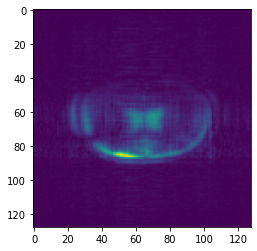

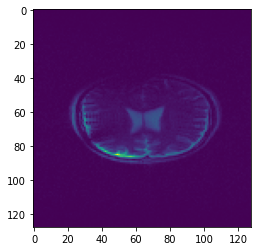

Time taken for epoch:  34.23898196220398
[2, 3]
Dev_Loss 0.0017784336902187516 Epoch 1
Epoch = [   1/ 250] TrainLoss = 0.003204  DevLoss = 0.001778 TrainTime = 17.6181s DevTime = 13.3399s


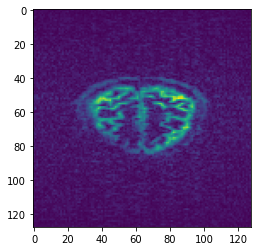

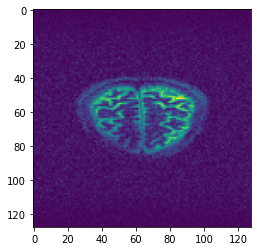

Time taken for epoch:  31.324491500854492
[2, 3]
Dev_Loss 0.0009284800595862377 Epoch 2
Epoch = [   2/ 250] TrainLoss = 0.002606  DevLoss = 0.0009285 TrainTime = 15.6356s DevTime = 13.8818s


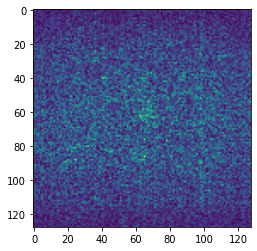

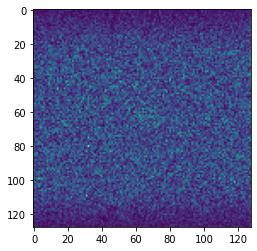

Time taken for epoch:  29.95392870903015
[2, 3]
Dev_Loss 0.0007336954346144429 Epoch 3
Epoch = [   3/ 250] TrainLoss = 0.002145  DevLoss = 0.0007337 TrainTime = 17.3698s DevTime = 13.6976s


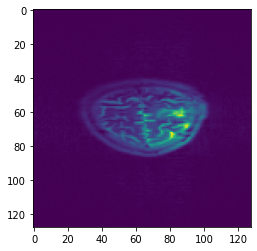

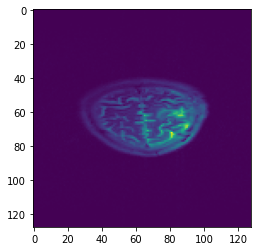

Time taken for epoch:  31.39904522895813
[2, 3]
Dev_Loss 0.0036127727578140283 Epoch 4
Epoch = [   4/ 250] TrainLoss = 0.001916  DevLoss = 0.003613 TrainTime = 17.3468s DevTime = 14.0892s


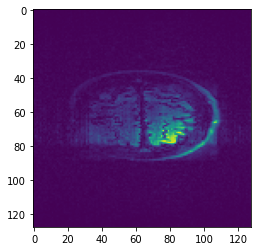

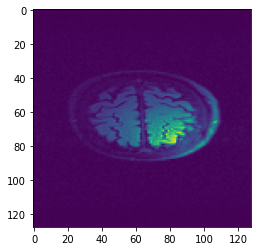

Time taken for epoch:  31.772592067718506
[2, 3]
Dev_Loss 0.000393402704960886 Epoch 5
Epoch = [   5/ 250] TrainLoss = 0.001837  DevLoss = 0.0003934 TrainTime = 16.0640s DevTime = 13.7805s


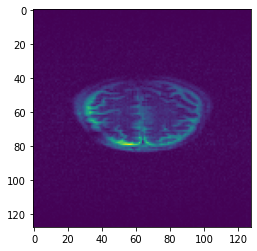

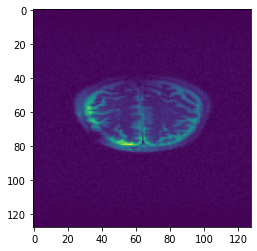

Time taken for epoch:  30.198763847351074
[2, 3]
Dev_Loss 0.00041923808774389955 Epoch 6
Epoch = [   6/ 250] TrainLoss = 0.001716  DevLoss = 0.0004192 TrainTime = 16.1207s DevTime = 13.9109s


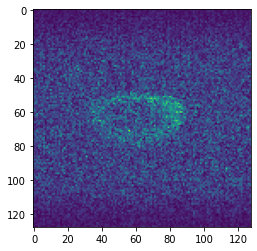

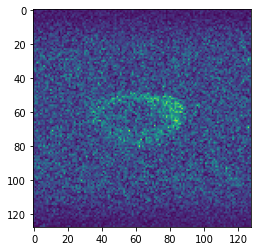

Time taken for epoch:  30.393598556518555
[2, 3]
Dev_Loss 0.0014181148580172571 Epoch 7
Epoch = [   7/ 250] TrainLoss = 0.001641  DevLoss = 0.001418 TrainTime = 16.7842s DevTime = 13.5938s


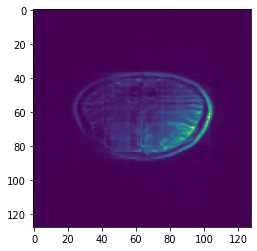

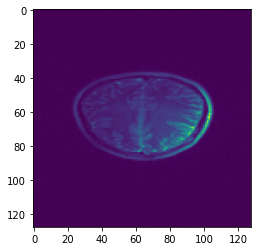

Time taken for epoch:  30.714893579483032
[2, 3]
Dev_Loss 0.00041918169626456426 Epoch 8
Epoch = [   8/ 250] TrainLoss = 0.001322  DevLoss = 0.0004192 TrainTime = 15.4322s DevTime = 13.6817s


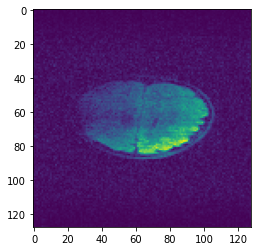

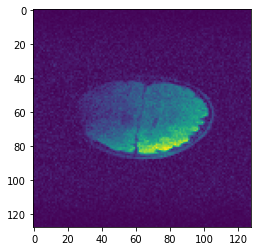

Time taken for epoch:  29.470296144485474
[2, 3]
Dev_Loss 0.0010930136859562492 Epoch 9
Epoch = [   9/ 250] TrainLoss = 0.001048  DevLoss = 0.001093 TrainTime = 16.5640s DevTime = 13.3434s


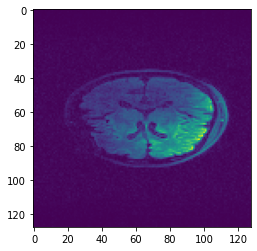

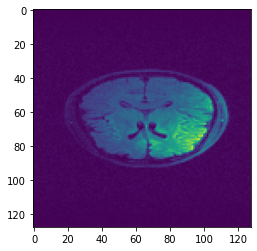

Time taken for epoch:  30.249602556228638
[2, 3]
Dev_Loss 0.0033430121815548794 Epoch 10
Epoch = [  10/ 250] TrainLoss = 0.001187  DevLoss = 0.003343 TrainTime = 15.3161s DevTime = 13.5042s


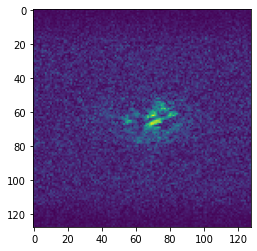

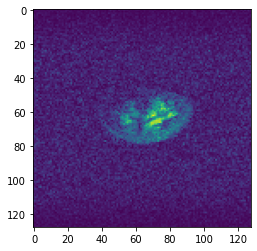

Time taken for epoch:  29.17685842514038
[2, 3]
Dev_Loss 0.006185391911055198 Epoch 11
Epoch = [  11/ 250] TrainLoss = 0.001316  DevLoss = 0.006185 TrainTime = 15.2751s DevTime = 13.6856s


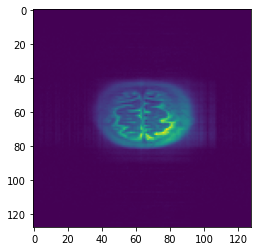

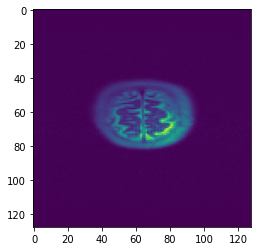

Time taken for epoch:  29.27195954322815
[2, 3]
Dev_Loss 0.001428460208018896 Epoch 12
Epoch = [  12/ 250] TrainLoss = 0.001126  DevLoss = 0.001428 TrainTime = 15.7574s DevTime = 13.7296s


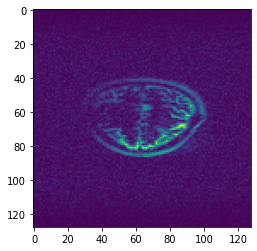

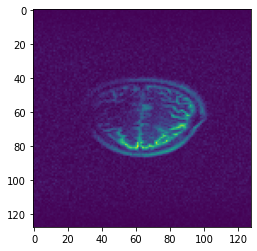

Time taken for epoch:  29.843066930770874
[2, 3]
Dev_Loss 0.001986065772949064 Epoch 13
Epoch = [  13/ 250] TrainLoss = 0.0009259  DevLoss = 0.001986 TrainTime = 16.6215s DevTime = 13.4530s


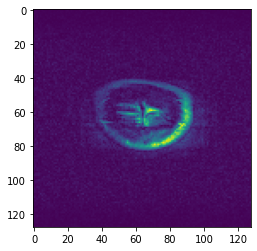

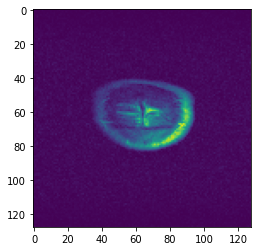

Time taken for epoch:  30.433884143829346
[2, 3]
Dev_Loss 0.00045276398976579625 Epoch 14
Epoch = [  14/ 250] TrainLoss = 0.00091  DevLoss = 0.0004528 TrainTime = 15.4459s DevTime = 13.5666s


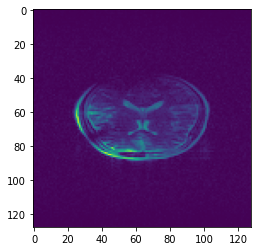

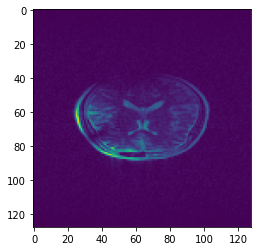

Time taken for epoch:  29.350187063217163
[2, 3]
Dev_Loss 0.0005819195733852437 Epoch 15
Epoch = [  15/ 250] TrainLoss = 0.0008874  DevLoss = 0.0005819 TrainTime = 16.0930s DevTime = 14.2925s


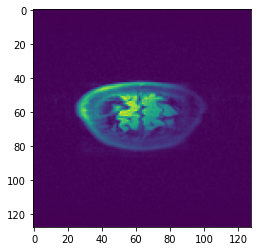

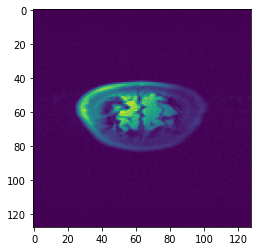

Time taken for epoch:  30.705793380737305
[2, 3]
Dev_Loss 0.0005363492324038816 Epoch 16
Epoch = [  16/ 250] TrainLoss = 0.0008232  DevLoss = 0.0005363 TrainTime = 16.1484s DevTime = 14.6484s


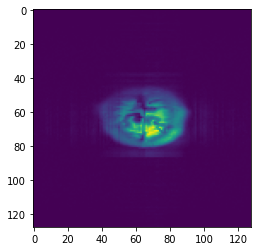

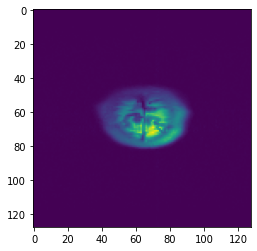

Time taken for epoch:  31.120763301849365
[2, 3]
Dev_Loss 4.985066179996878e-05 Epoch 17
Epoch = [  17/ 250] TrainLoss = 0.0007541  DevLoss = 4.985e-05 TrainTime = 16.8742s DevTime = 13.2870s


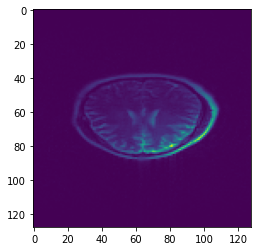

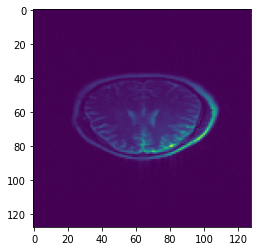

Time taken for epoch:  30.51253342628479
[2, 3]
Dev_Loss 0.00015555863485045788 Epoch 18
Epoch = [  18/ 250] TrainLoss = 0.000638  DevLoss = 0.0001556 TrainTime = 18.4333s DevTime = 14.0020s


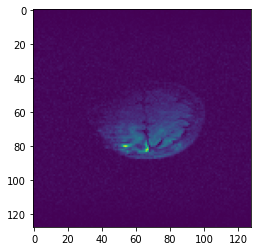

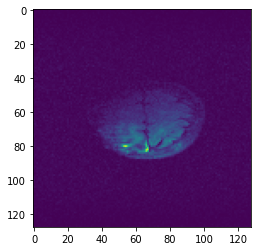

Time taken for epoch:  32.78975701332092
[2, 3]
Dev_Loss 0.0013093247356405226 Epoch 19
Epoch = [  19/ 250] TrainLoss = 0.0006671  DevLoss = 0.001309 TrainTime = 15.6609s DevTime = 13.7557s


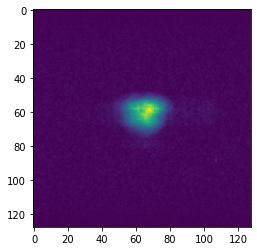

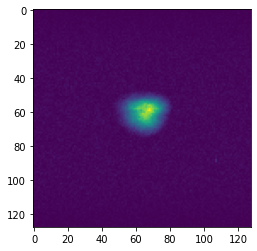

Time taken for epoch:  29.783341884613037
[2, 3]
Dev_Loss 0.00020164032042487378 Epoch 20
Epoch = [  20/ 250] TrainLoss = 0.001041  DevLoss = 0.0002016 TrainTime = 17.3214s DevTime = 13.6583s


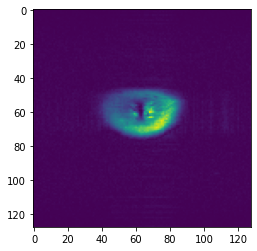

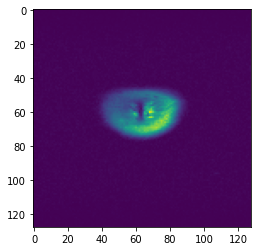

Time taken for epoch:  31.326903820037842
[2, 3]
Dev_Loss 0.0004763202717776381 Epoch 21
Epoch = [  21/ 250] TrainLoss = 0.0006827  DevLoss = 0.0004763 TrainTime = 16.2484s DevTime = 13.3219s


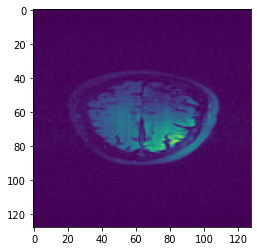

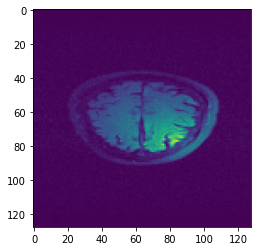

Time taken for epoch:  30.031543254852295
[2, 3]
Dev_Loss 0.0010871444893355436 Epoch 22
Epoch = [  22/ 250] TrainLoss = 0.00071  DevLoss = 0.001087 TrainTime = 15.1169s DevTime = 13.4977s


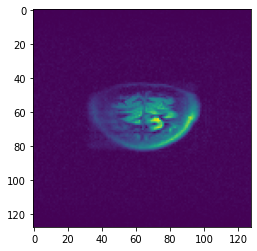

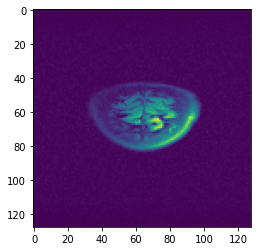

Time taken for epoch:  28.945167064666748
[2, 3]
Dev_Loss 0.007956327865836388 Epoch 23
Epoch = [  23/ 250] TrainLoss = 0.0006969  DevLoss = 0.007956 TrainTime = 15.2195s DevTime = 13.7499s


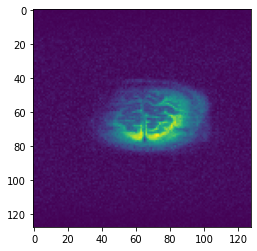

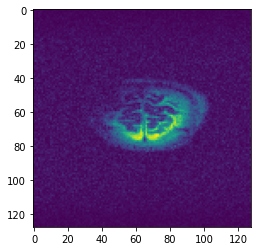

Time taken for epoch:  29.313491821289062
[2, 3]
Dev_Loss 3.2990960126001945e-05 Epoch 24
Epoch = [  24/ 250] TrainLoss = 0.001098  DevLoss = 3.299e-05 TrainTime = 16.1678s DevTime = 13.4593s


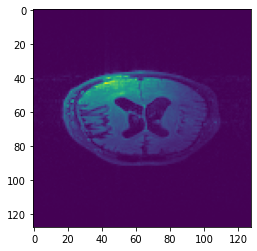

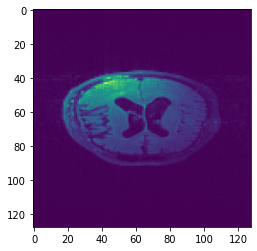

Time taken for epoch:  29.949745893478394
[2, 3]
Dev_Loss 0.0004023360857970936 Epoch 25
Epoch = [  25/ 250] TrainLoss = 0.0006675  DevLoss = 0.0004023 TrainTime = 16.2459s DevTime = 13.5737s


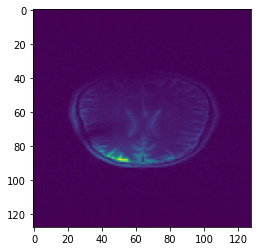

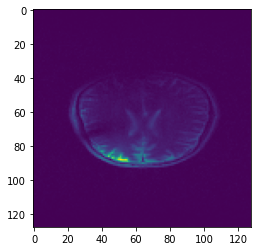

Time taken for epoch:  30.142860889434814
[2, 3]
Dev_Loss 0.00014774587321083056 Epoch 26
Epoch = [  26/ 250] TrainLoss = 0.0006008  DevLoss = 0.0001477 TrainTime = 15.6927s DevTime = 13.6347s


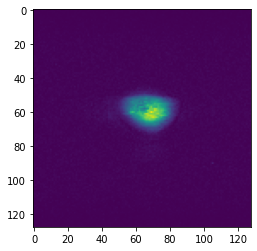

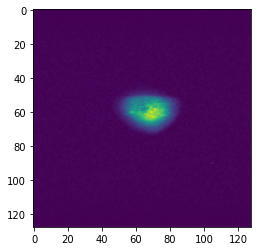

Time taken for epoch:  29.66864848136902
[2, 3]
Dev_Loss 8.94985406614234e-05 Epoch 27
Epoch = [  27/ 250] TrainLoss = 0.0006409  DevLoss = 8.95e-05 TrainTime = 15.4720s DevTime = 13.3057s


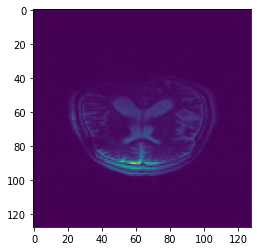

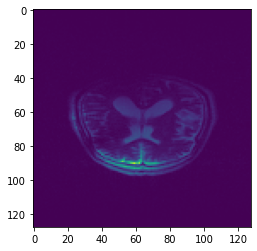

Time taken for epoch:  29.11701512336731
[2, 3]
Dev_Loss 0.005782969322135758 Epoch 28
Epoch = [  28/ 250] TrainLoss = 0.0006743  DevLoss = 0.005783 TrainTime = 15.7270s DevTime = 13.3368s


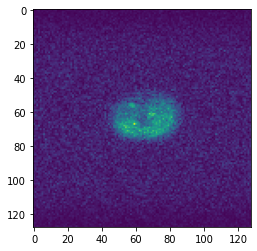

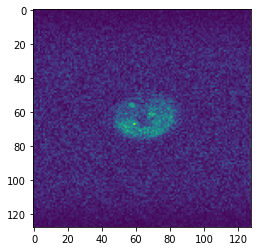

Time taken for epoch:  29.42760944366455
[2, 3]
Dev_Loss 0.0003163409346782766 Epoch 29
Epoch = [  29/ 250] TrainLoss = 0.000932  DevLoss = 0.0003163 TrainTime = 15.0793s DevTime = 13.3547s


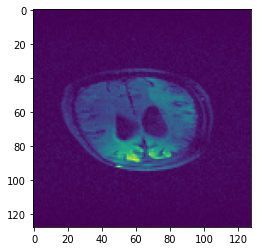

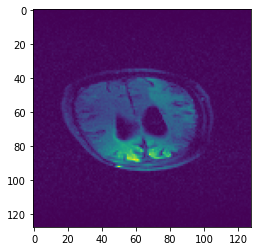

Time taken for epoch:  28.785128355026245
[2, 3]
Dev_Loss 0.0006915193879182329 Epoch 30
Epoch = [  30/ 250] TrainLoss = 0.000835  DevLoss = 0.0006915 TrainTime = 15.5061s DevTime = 13.2815s


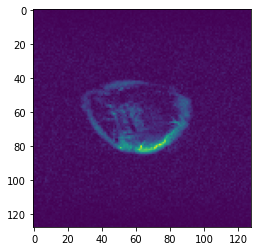

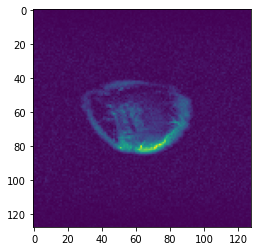

Time taken for epoch:  29.129103660583496
[2, 3]
Dev_Loss 0.00011034441984888356 Epoch 31
Epoch = [  31/ 250] TrainLoss = 0.0006676  DevLoss = 0.0001103 TrainTime = 15.5723s DevTime = 13.5885s


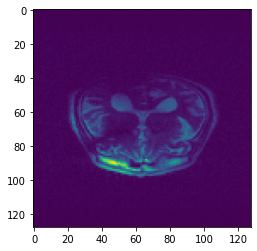

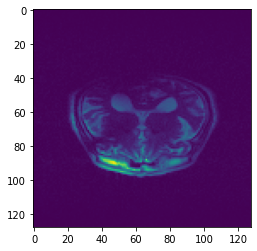

Time taken for epoch:  29.501341819763184
[2, 3]


In [ ]:
def train(args): 
    args.exp_dir.mkdir(parents=True, exist_ok=True)
    writer = SummaryWriter(logdir=str(args.logdir)) #log directory for run

    if args.resume: #be aware of the option
        checkpoint, model, optimizer = load_model(args.checkpoint,args)
        args = checkpoint['args']
        best_dev_loss = checkpoint['best_dev_loss']
        #start_epoch = checkpoint['epoch']
        start_epoch = 0
        del checkpoint
    else:
        model = build_model(args)
        optimizer = build_optim(args, model.parameters())
        best_dev_loss = 1e9
        start_epoch = 0
    logging.info(args)
    logging.info(model)

    #train_loader,dev_loader,test_loader = create_data_loaders()
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, args.lr_step_size, args.lr_gamma)
    optimizer.step()

    for epoch in range(start_epoch, args.num_epochs):
        ti=time.time()
        scheduler.step(epoch)
        train_loss, train_time = train_epoch(args, epoch, model, train_loader, optimizer, writer)
        dev_loss, dev_time = evaluate(args, epoch, model, dev_loader, writer)
        #visualize(args, epoch, model, train_loader, writer)

        is_new_best = dev_loss < best_dev_loss
        best_dev_loss = min(best_dev_loss, dev_loss)
        save_model(args, args.exp_dir, epoch, model, optimizer, best_dev_loss, is_new_best)
        print(f'Epoch = [{epoch:4d}/{args.num_epochs:4d}] TrainLoss = {train_loss:.4g} ',
        f'DevLoss = {dev_loss:.4g} TrainTime = {train_time:.4f}s DevTime = {dev_time:.4f}s')
        
        for iter, data in enumerate(train_loader):
            kspace, full = data
            input = kspace.to(f'{args.device}:{model.device_ids[0]}')
            target = full.to(f'{args.device}:{model.device_ids[0]}')
            output_r,output_i = model(input)
            output_r=output_r.to('cpu').detach().numpy()
            output_i=output_i.to('cpu').detach().numpy()
            output = output_r+output_i*1j
            image = abs(output.squeeze(1))
            #print(output)
            plt.imshow(image[0,:,:])
            plt.show()
            plt.imshow(target[0,:,:].to('cpu').detach().numpy())
            plt.show()
            break;
        
        logging.info(
            f'Epoch = [{epoch:4d}/{args.num_epochs:4d}] TrainLoss = {train_loss:.4g} '
            f'DevLoss = {dev_loss:.4g} TrainTime = {train_time:.4f}s DevTime = {dev_time:.4f}s',
        )
        print("Time taken for epoch: ",time.time()-ti)
    writer.close()
    return dev_loss
    
train(args)

In [29]:
def train(args): 
    args.exp_dir.mkdir(parents=True, exist_ok=True)
    writer = SummaryWriter(logdir=str(args.logdir)) #log directory for run

    if args.resume: #be aware of the option
        checkpoint, model, optimizer = load_model(args.checkpoint,args)
        args = checkpoint['args']
        best_dev_loss = checkpoint['best_dev_loss']
        #start_epoch = checkpoint['epoch']
        start_epoch = 0
        del checkpoint
    else:
        model = build_model(args)
        optimizer = build_optim(args, model.parameters())
        best_dev_loss = 1e9
        start_epoch = 0
    logging.info(args)
    logging.info(model)

    #train_loader,dev_loader,test_loader = create_data_loaders()
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, args.lr_step_size, args.lr_gamma)
    optimizer.step()

    for epoch in range(start_epoch, args.num_epochs):
        ti=time.time()
        scheduler.step(epoch)
        train_loss, train_time = train_epoch(args, epoch, model, train_loader, optimizer, writer)
        dev_loss, dev_time = evaluate(args, epoch, model, dev_loader, writer)
        #visualize(args, epoch, model, train_loader, writer)

        is_new_best = dev_loss < best_dev_loss
        best_dev_loss = min(best_dev_loss, dev_loss)
        save_model(args, args.exp_dir, epoch, model, optimizer, best_dev_loss, is_new_best)
        print(f'Epoch = [{epoch:4d}/{args.num_epochs:4d}] TrainLoss = {train_loss:.4g} ',
        f'DevLoss = {dev_loss:.4g} TrainTime = {train_time:.4f}s DevTime = {dev_time:.4f}s')
        
        for iter, data in enumerate(train_loader):
            kspace, full = data
            input = kspace.to(f'{args.device}:{model.device_ids[0]}')
            target = full.to(f'{args.device}:{model.device_ids[0]}')
            output_r,output_i = model(input)
            output_r=output_r.to('cpu').detach().numpy()
            output_i=output_i.to('cpu').detach().numpy()
            output = output_r+output_i*1j
            image = abs(output.squeeze(1))
            #print(output)
            plt.imshow(image[0,:,:])
            plt.show()
            plt.imshow(target[0,:,:].to('cpu').detach().numpy())
            plt.show()
            break;
        
        logging.info(
            f'Epoch = [{epoch:4d}/{args.num_epochs:4d}] TrainLoss = {train_loss:.4g} '
            f'DevLoss = {dev_loss:.4g} TrainTime = {train_time:.4f}s DevTime = {dev_time:.4f}s',
        )
        print("Time taken for epoch: ",time.time()-ti)
    writer.close()
    return dev_loss

Model build successfully
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size(

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.006646855457882268 Epoch 0
Epoch = [   0/ 250] TrainLoss = 2.269  DevLoss = 0.006647 TrainTime = 15.5160s DevTime = 13.4776s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


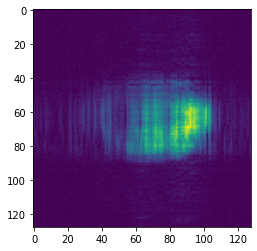

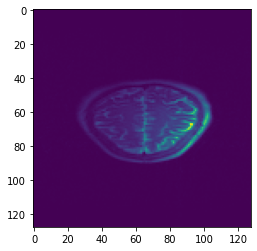

Time taken for epoch:  29.31487798690796
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.00536555168015579 Epoch 1
Epoch = [   1/ 250] TrainLoss = 0.004458  DevLoss = 0.005366 TrainTime = 15.4814s DevTime = 13.5291s
torch.Size([4, 1, 256

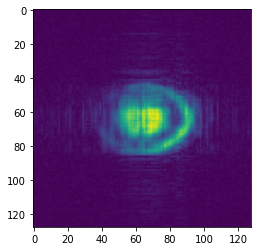

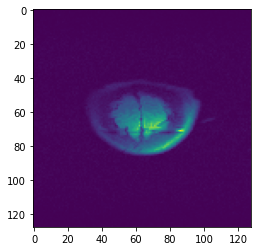

Time taken for epoch:  29.3477463722229
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 25

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.00519547182902787 Epoch 2
Epoch = [   2/ 250] TrainLoss = 0.00412  DevLoss = 0.005195 TrainTime = 15.5132s DevTime = 13.4136s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


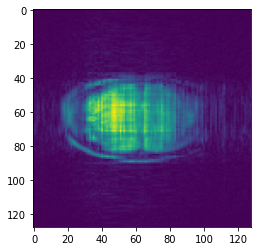

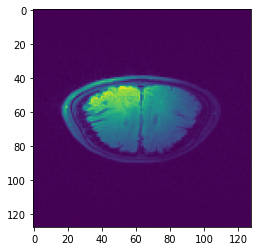

Time taken for epoch:  29.283334732055664
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004758625171528921 Epoch 3
Epoch = [   3/ 250] TrainLoss = 0.003953  DevLoss = 0.004759 TrainTime = 15.7614s DevTime = 13.3716s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


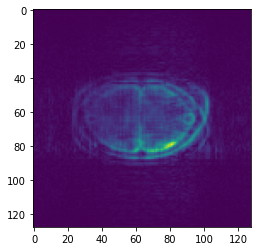

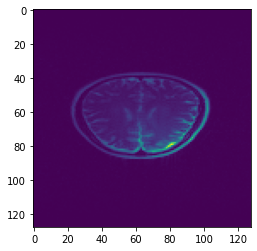

Time taken for epoch:  29.473967790603638
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004331434086052468 Epoch 4
Epoch = [   4/ 250] TrainLoss = 0.003772  DevLoss = 0.004331 TrainTime = 15.4028s DevTime = 13.2904s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 25

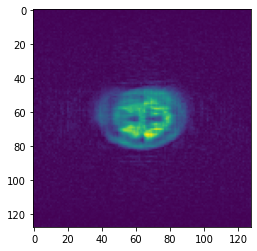

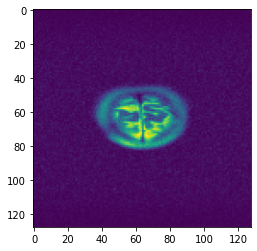

Time taken for epoch:  29.0571072101593
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 25

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0046339756252518505 Epoch 5
Epoch = [   5/ 250] TrainLoss = 0.003593  DevLoss = 0.004634 TrainTime = 15.3740s DevTime = 13.3058s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


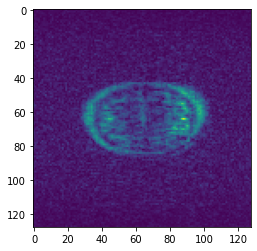

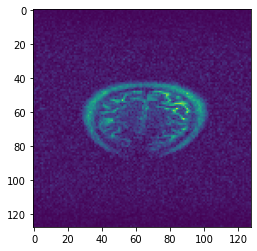

Time taken for epoch:  29.02958917617798
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004462691485340485 Epoch 6
Epoch = [   6/ 250] TrainLoss = 0.003613  DevLoss = 0.004463 TrainTime = 15.6166s DevTime = 13.4202s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 25

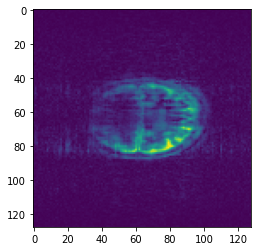

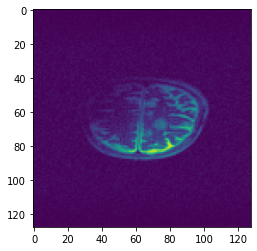

Time taken for epoch:  29.386614322662354
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004323913728804837 Epoch 7
Epoch = [   7/ 250] TrainLoss = 0.003563  DevLoss = 0.004324 TrainTime = 15.7899s DevTime = 13.3017s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


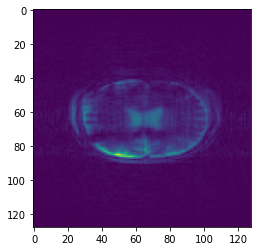

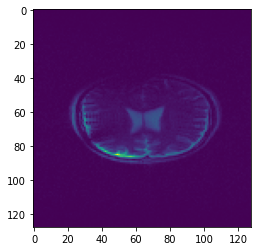

Time taken for epoch:  29.447285652160645
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004390117621214055 Epoch 8
Epoch = [   8/ 250] TrainLoss = 0.003369  DevLoss = 0.00439 TrainTime = 15.5265s DevTime = 13.3645s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


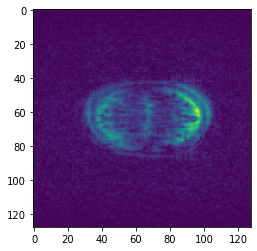

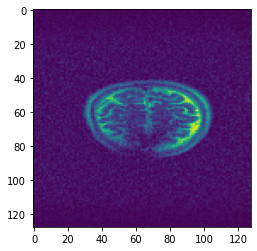

Time taken for epoch:  29.26739001274109
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004723014233060119 Epoch 9
Epoch = [   9/ 250] TrainLoss = 0.003492  DevLoss = 0.004723 TrainTime = 15.5551s DevTime = 13.4266s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


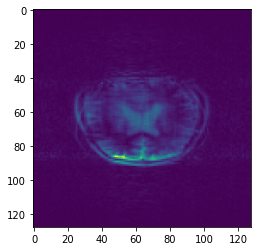

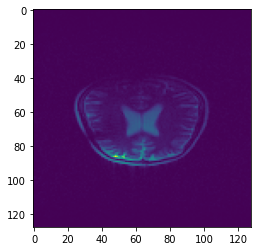

Time taken for epoch:  29.32516884803772
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0048185431875888375 Epoch 10
Epoch = [  10/ 250] TrainLoss = 0.003434  DevLoss = 0.004819 TrainTime = 15.5321s DevTime = 13.4828s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


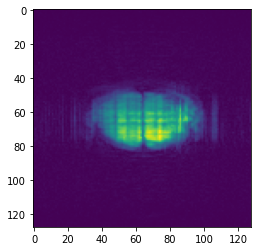

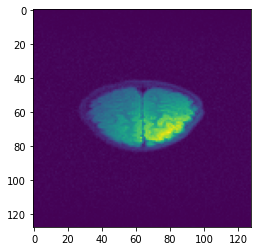

Time taken for epoch:  29.350162506103516
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004647933894762304 Epoch 11
Epoch = [  11/ 250] TrainLoss = 0.003624  DevLoss = 0.004648 TrainTime = 15.4270s DevTime = 13.3700s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


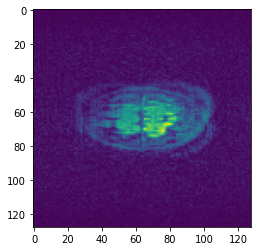

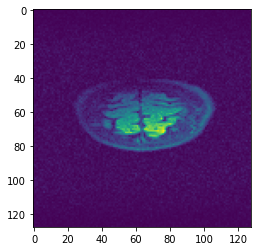

Time taken for epoch:  29.13774824142456
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004189143105316059 Epoch 12
Epoch = [  12/ 250] TrainLoss = 0.003394  DevLoss = 0.004189 TrainTime = 15.3646s DevTime = 13.3704s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


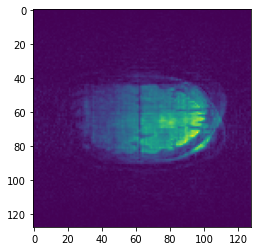

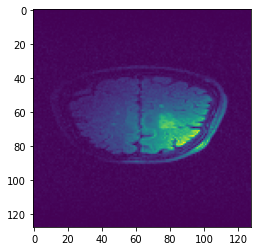

Time taken for epoch:  29.08548378944397
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004598762929608803 Epoch 13
Epoch = [  13/ 250] TrainLoss = 0.003295  DevLoss = 0.004599 TrainTime = 15.6668s DevTime = 13.5229s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


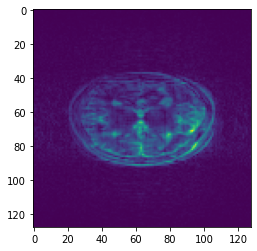

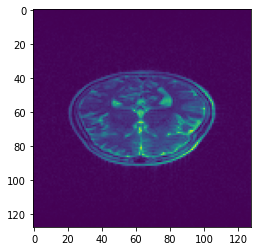

Time taken for epoch:  29.518749237060547
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004547758049122762 Epoch 14
Epoch = [  14/ 250] TrainLoss = 0.003291  DevLoss = 0.004548 TrainTime = 15.3946s DevTime = 13.3761s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


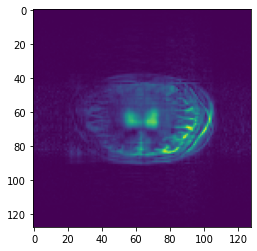

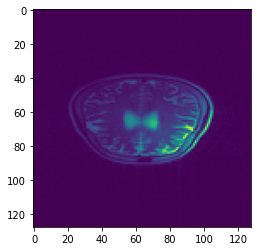

Time taken for epoch:  29.094476461410522
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004505181426417014 Epoch 15
Epoch = [  15/ 250] TrainLoss = 0.003517  DevLoss = 0.004505 TrainTime = 15.3661s DevTime = 13.4901s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


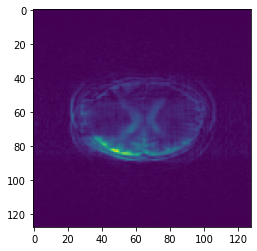

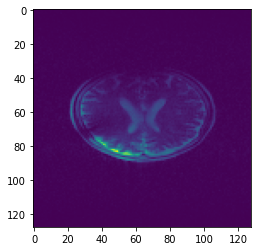

Time taken for epoch:  29.19094228744507
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.005248490167385675 Epoch 16
Epoch = [  16/ 250] TrainLoss = 0.003327  DevLoss = 0.005248 TrainTime = 15.3733s DevTime = 13.4319s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


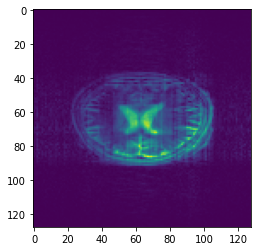

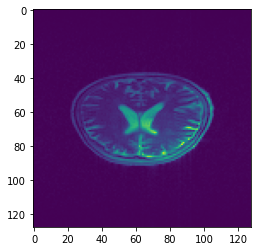

Time taken for epoch:  29.150100708007812
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.00492391688634398 Epoch 17
Epoch = [  17/ 250] TrainLoss = 0.003579  DevLoss = 0.004924 TrainTime = 15.4415s DevTime = 13.2617s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


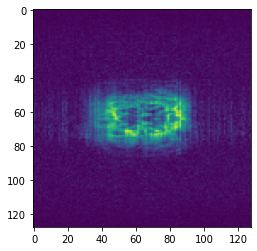

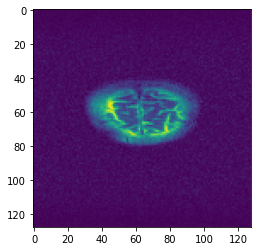

Time taken for epoch:  29.06881809234619
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004880669162876013 Epoch 18
Epoch = [  18/ 250] TrainLoss = 0.003421  DevLoss = 0.004881 T

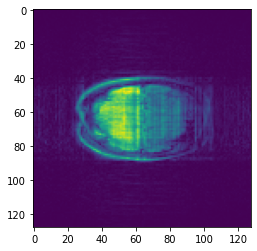

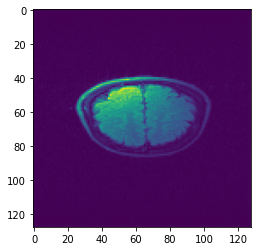

Time taken for epoch:  29.257538318634033
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0043041737184456655 Epoch 19
Epoch = [  19/ 250] TrainLoss = 0.003126  DevLoss = 0.004304 TrainTime = 15.5911s DevTime = 13.4526s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


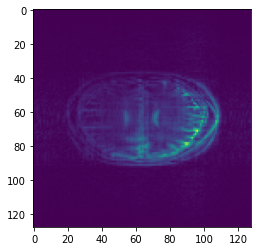

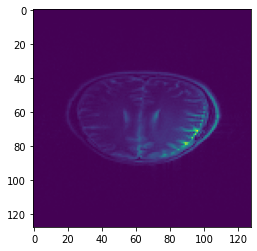

Time taken for epoch:  29.35764241218567
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004836857443887448 Epoch 20
Epoch = [  20/ 250] TrainLoss = 0.003307  DevLoss = 0.004837 TrainTime = 15.6290s DevTime = 13.2980s
torch.Size([4, 1, 2

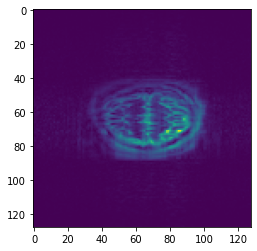

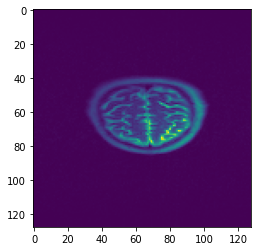

Time taken for epoch:  29.2543625831604
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 25

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004

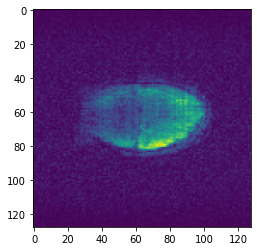

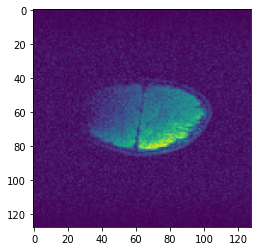

Time taken for epoch:  28.9486300945282
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 25

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.00526569985338032 Epoch 22
Epoch = [  22/ 250] TrainLoss = 0.003291  DevLoss = 0.005266 TrainTime = 15.4344s DevTime = 13.3445s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


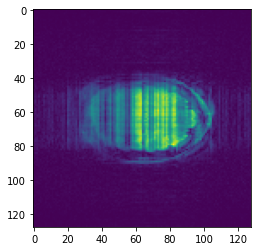

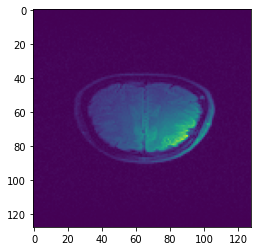

Time taken for epoch:  29.10281538963318
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004503132316738262 Epoch 23
Epoch = [  23/ 250] TrainLoss = 0.003465  DevLoss = 0.004503 TrainTime = 15.4968s DevTime = 13.4321s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


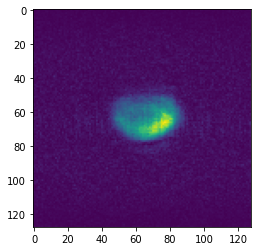

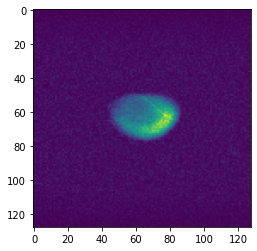

Time taken for epoch:  29.284893035888672
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0050400595744954525 Epoch 24
Epoch = [  24/ 250] TrainLoss = 0.003369  DevLoss = 0.00504 TrainTime = 15.7050s DevTime = 13.5317s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


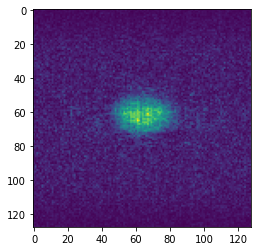

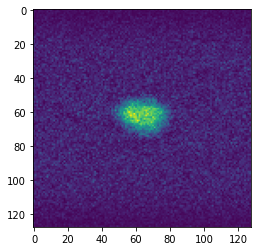

Time taken for epoch:  29.599043369293213
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004527268515062878 Epoch 25
Epoch = [  25/ 250] TrainLoss = 0.003228  DevLoss = 0.004527 TrainTime = 15.4471s DevTime = 13.3244s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


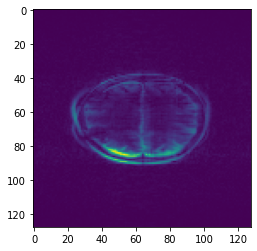

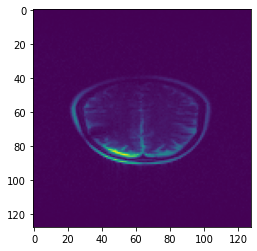

Time taken for epoch:  29.1067898273468
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 25

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004372946837875744 Epoch 26
Epoch = [  26/ 250] TrainLoss = 0

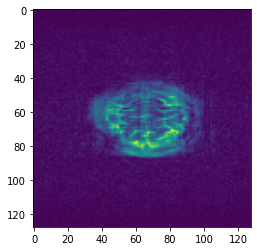

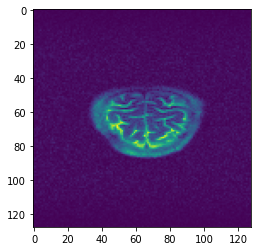

Time taken for epoch:  29.26175093650818
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004324156151040449 Epoch 27
Epoch = [  27/ 250] TrainLoss = 0.00338  DevLoss = 0.004324 TrainTime = 15.2843s DevTime = 13.3824s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


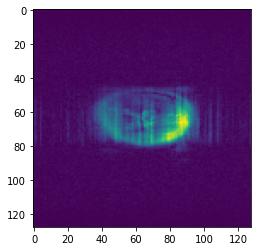

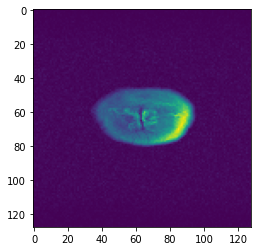

Time taken for epoch:  29.014283895492554
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.005102739891460369 Epoch 28
Epoch = [  28/ 250] TrainLoss = 0.003038  DevLoss = 0.005103 TrainTime = 15.5963s DevTime = 13.2413s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


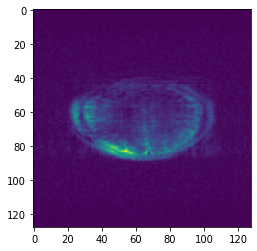

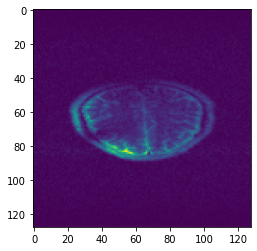

Time taken for epoch:  29.196136713027954
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.005122672773667842 Epoch 29
Epoch = [  29/ 250] TrainLoss = 0.003218  DevLoss = 0.005123 TrainTime = 15.3211s DevTime = 13.3962s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


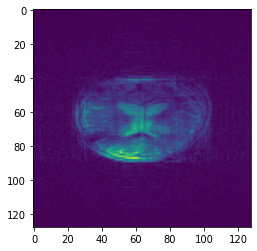

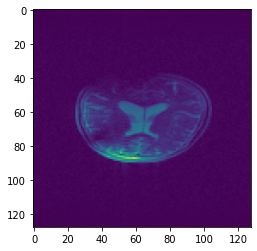

Time taken for epoch:  29.06103539466858
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0043269261180949444 Epoch 30
Epoch = [  30/ 250] TrainLoss = 0.003069  DevLoss = 0.004327 TrainTime = 15.4578s DevTime = 13.3615s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


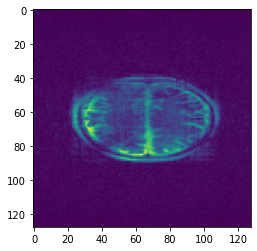

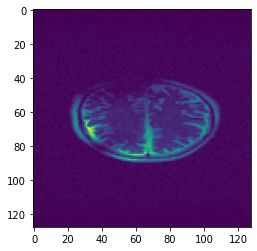

Time taken for epoch:  29.16347908973694
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004635920534211914 Epoch 31
Epoch = [  31/ 250] TrainLoss = 0.003049  DevLoss = 0.004636 TrainTime = 15.3514s DevTime = 13.4654s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


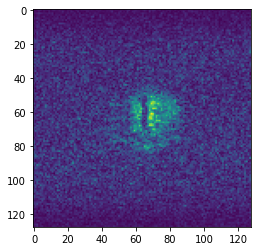

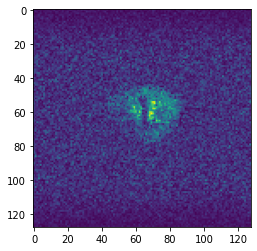

Time taken for epoch:  29.16274929046631
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004149080503254237 Epoch 32
Epoch = [  32/ 250] TrainLoss = 0.003005  DevLoss = 0.004149 TrainTime = 15.5764s DevTime = 13.5497s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


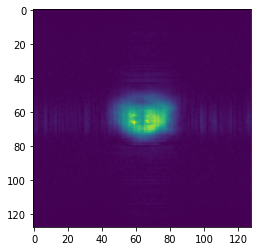

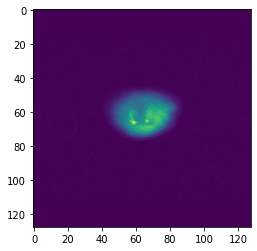

Time taken for epoch:  29.45224118232727
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004784496878553429 Epoch 33
Epoch = [  33/ 250] TrainLoss = 0.00303  DevLoss = 0.004784 TrainTime = 15.6156s DevTime = 13.2698s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


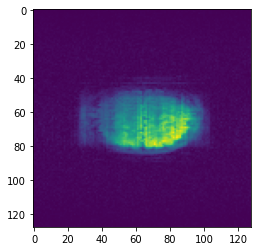

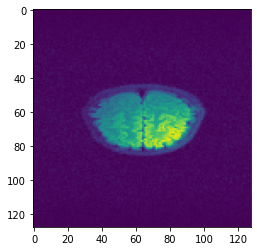

Time taken for epoch:  29.243207693099976
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0043666871755217475 Epoch 34
Epoch = [  34/ 250] TrainLoss = 0.00297  DevLoss = 0.004367 TrainTime = 15.5087s DevTime = 13.1055s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


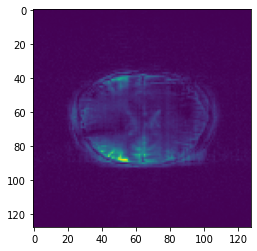

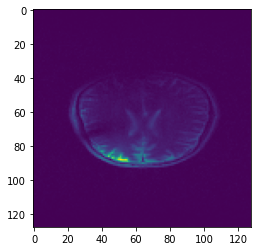

Time taken for epoch:  28.95992946624756
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0044766202372352295 Epoch 35
Epoch = [  35/ 250] TrainLoss = 0.003025  DevLoss = 0.004477 TrainTime = 15.5720s DevTime = 13.2261s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 

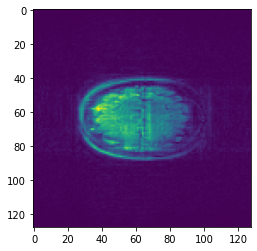

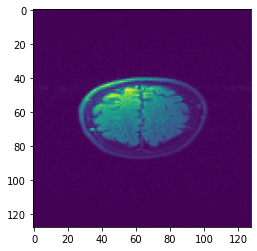

Time taken for epoch:  29.122518062591553
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.005130315292772174 Epoch 36
Epoch = [  36/ 250] TrainLoss = 0.00288  DevLoss = 0.00513 TrainTime = 15.2973s DevTime = 13.4262s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


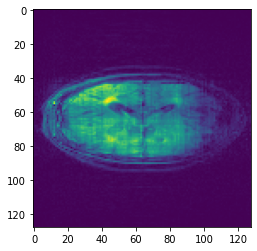

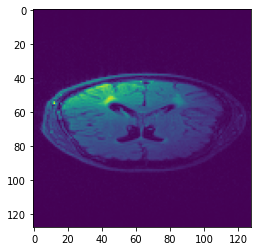

Time taken for epoch:  29.036325693130493
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004437287782811231 Epoch 37
Epoch = [  37/ 250] TrainLoss = 0.003063  DevLoss = 0.004437 TrainTime = 15.5414s DevTime = 13.3698s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


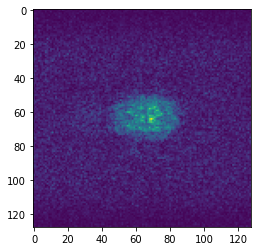

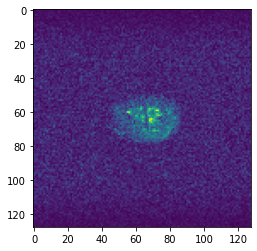

Time taken for epoch:  29.259932041168213
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0039934676626775965 Epoch 38
Epoch = [  38/ 250] TrainLoss = 0.003043  DevLoss = 0.003993 TrainTime = 15.4549s DevTime = 13.3682s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


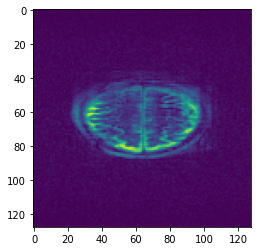

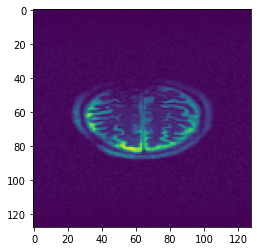

Time taken for epoch:  29.15896463394165
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004113020092214263 Epoch 39
Epoch = [  39/ 250] TrainLoss = 0.002915  DevLoss = 0.004113 TrainTime = 15.6221s DevTime = 13.1005s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


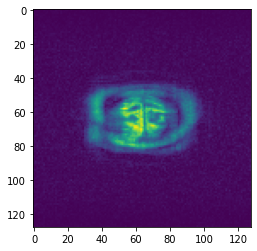

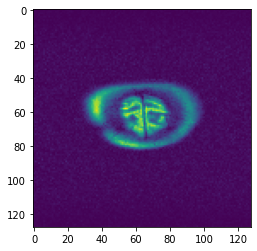

Time taken for epoch:  29.06631088256836
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.005188736898837307 Epoch 40
Epoch = [  40/ 250] TrainLoss = 0.002896  DevLoss = 0.005189 TrainTime = 15.7033s DevTime = 13.5143s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


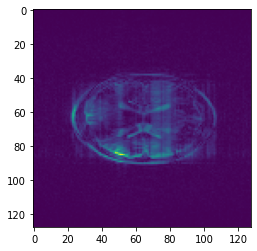

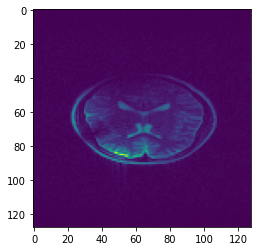

Time taken for epoch:  29.548807382583618
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.005007208890482356 Epoch 41
Epoch = [  41/ 250] TrainLoss = 0.003007  DevLoss = 0.005007 TrainTime = 15.5271s DevTime = 13.4737s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


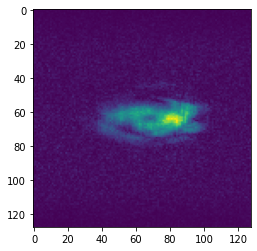

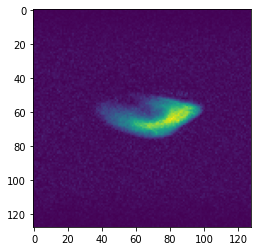

Time taken for epoch:  29.342641830444336
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.006803839611260624 Epoch 42
Epoch = [  42/ 250] TrainLoss = 0.002827  DevLoss = 0.006804 TrainTime = 15.1683s DevTime = 12.4257s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


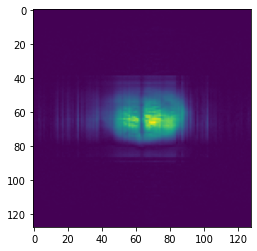

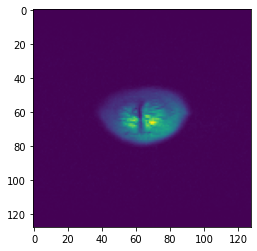

Time taken for epoch:  27.933221340179443
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004378988374359186 Epoch 43
Epoch = [  43/ 250] TrainLoss = 0.003039  DevLoss = 0.004379 TrainTime = 15.4793s DevTime = 13.3734s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


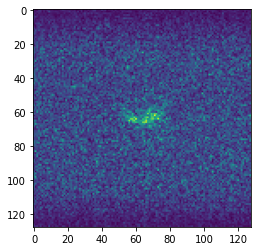

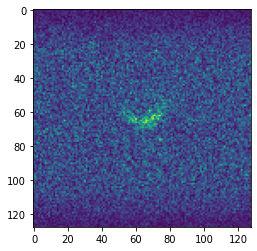

Time taken for epoch:  29.20314359664917
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004249026503196178 Epoch 44
Epoch = [  44/ 250] TrainLoss = 0.00288  DevLoss = 0.004249 TrainTime = 15.3843s DevTime = 13.3651s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


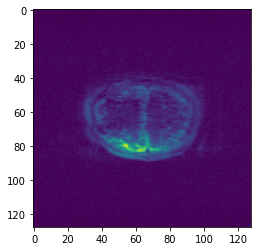

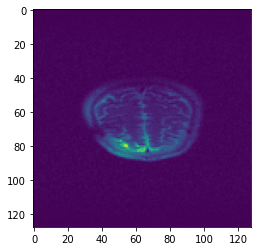

Time taken for epoch:  29.08406376838684
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004433079723564841 Epoch 45
Epoch = [  45/ 250] TrainLoss = 0.002842  DevLoss = 0.004433 TrainTime = 15.4920s DevTime = 13.2894s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


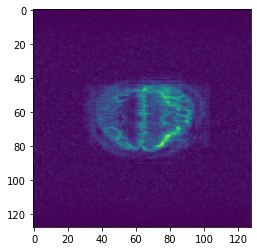

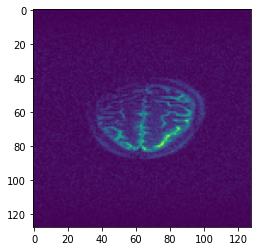

Time taken for epoch:  29.130356073379517
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004248103921331698 Epoch 46
Epoch = [  46/ 250] TrainLoss = 0.002897  DevLoss = 0.004248 TrainTime = 15.4014s DevTime = 13.4855s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 2

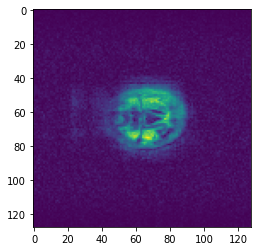

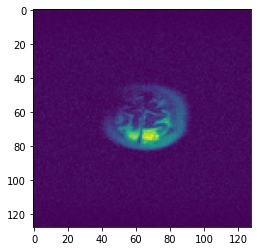

Time taken for epoch:  29.246323823928833
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.00446372772334764 Epoch 47
Epoch = [  47/ 250] TrainLoss = 0.00285  DevLoss = 0.004464 TrainTime = 15.3352s DevTime = 13.5455s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


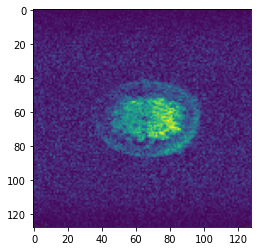

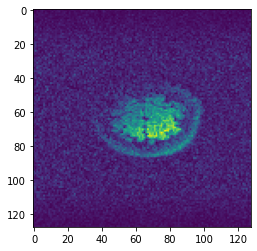

Time taken for epoch:  29.235513925552368
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004889866786281931 Epoch 48
Epoch = [  48/ 250] TrainLoss = 0.003027  DevLoss = 0.00489 TrainTime = 15.5237s DevTime = 13.3292s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


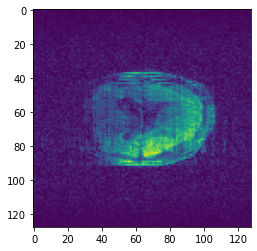

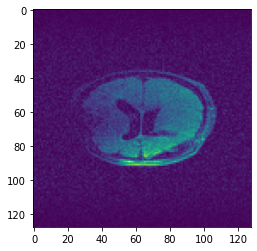

Time taken for epoch:  29.20835018157959
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0041049812947049485 Epoch 49
Epoch = [  49/ 250] TrainLoss = 0.002888  DevLoss = 0.004105 TrainTime = 15.5310s DevTime = 13.3575s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


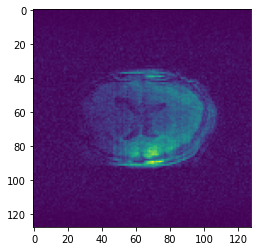

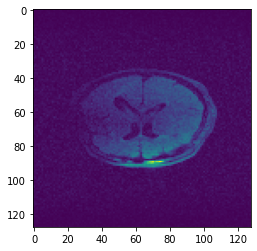

Time taken for epoch:  29.2397723197937
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 25

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004598311784384706 Epoch 50
Epoch = [  50/ 250] TrainLoss = 0.003016  DevLoss = 0.004598 TrainTime = 15.3228s DevTime = 13.3658s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 2

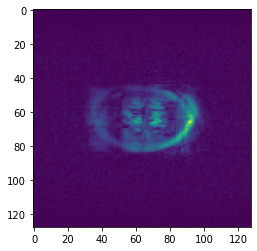

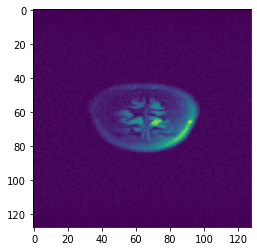

Time taken for epoch:  29.023401975631714
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0040634372136644425 Epoch 51
Epoch = [  51/ 250] TrainLoss = 0.002858  DevLoss = 0.004063 TrainTime = 15.5195s DevTime = 13.2350s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


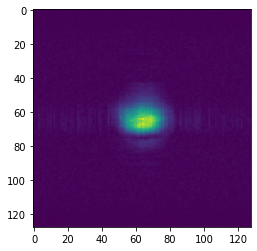

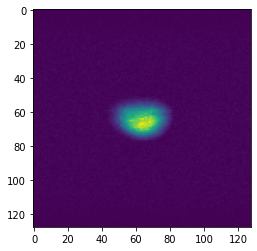

Time taken for epoch:  29.080668926239014
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004816427317433552 Epoch 52
Epoch = [  52/ 250] TrainLoss = 0.002918  DevLoss = 0.004816 TrainTime = 15.5706s DevTime = 13.3608s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 2

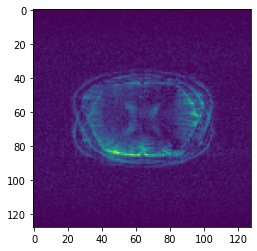

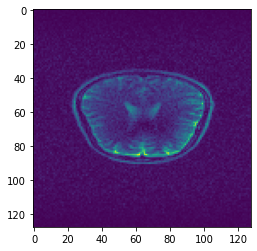

Time taken for epoch:  29.28019118309021
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004626143416632275 Epoch 53
Epoch = [  53/ 250] TrainLoss = 0.002932  DevLoss = 0.004626 TrainTime = 15.6377s DevTime = 13.4867s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


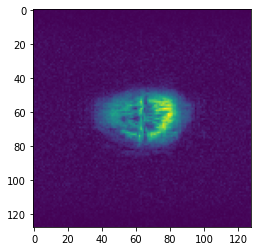

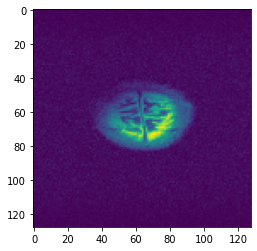

Time taken for epoch:  29.456037044525146
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004381628013293149 Epoch 54
Epoch = [  54/ 250] TrainLoss = 0.002801  DevLoss = 0.004382 TrainTime = 15.5237s DevTime = 13.4367s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


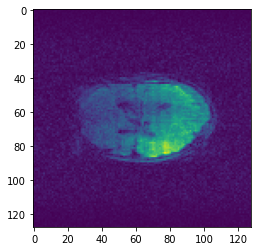

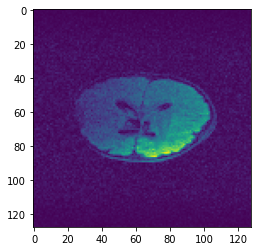

Time taken for epoch:  29.312175512313843
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004194251583531787 Epoch 55
Epoch = [  55/ 250] TrainLoss = 0.002761  DevLoss = 0.004194 TrainTime = 15.6145s DevTime = 13.3855s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


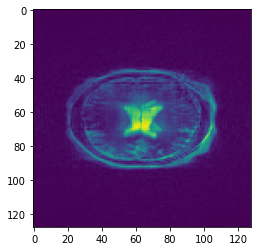

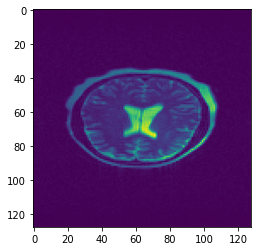

Time taken for epoch:  29.315135955810547
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004860756888018032 Epoch 56
Epoch = [  56/ 250] TrainLoss = 0.00284  DevLoss = 0.004861 TrainTime = 15.4589s DevTime = 13.1625s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


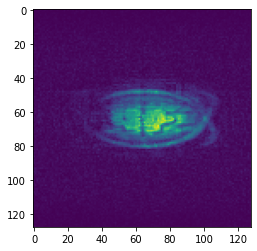

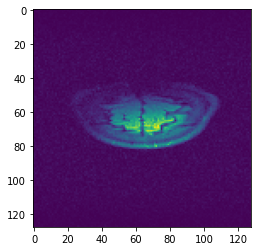

Time taken for epoch:  28.97825336456299
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004068422738630227 Epoch 57
Epoch = [  57/ 250] TrainLoss = 0.002796  DevLoss = 0.004068 TrainTime = 15.5681s DevTime = 12.9703s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


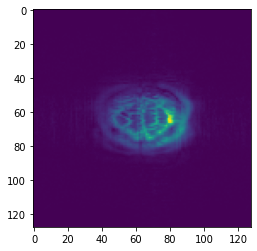

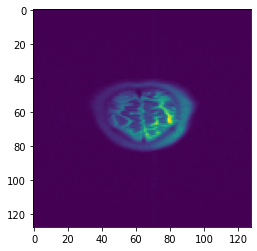

Time taken for epoch:  28.84711003303528
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.003978613871979274 Epoch 58
Epoch = [  58/ 250] TrainLoss = 0

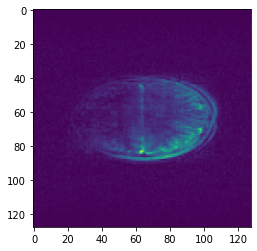

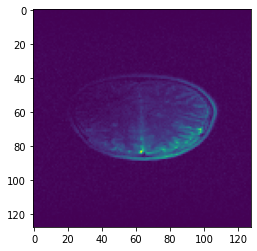

Time taken for epoch:  29.2867751121521
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 25

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004258753824956307 Epoch 59
Epoch = [  59/ 250] TrainLoss = 0.002782  DevLoss = 0.004259 TrainTime = 15.6830s DevTime = 13.5493s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


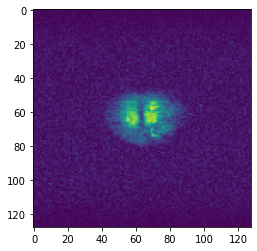

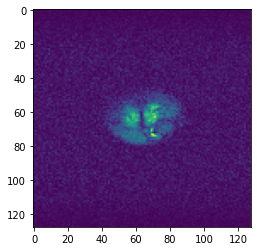

Time taken for epoch:  29.580276250839233
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0049215415282209095 Epoch 60
Epoch = [  60/ 250] TrainLoss = 0.002851  DevLoss = 0.004922 TrainTime = 15.5769s DevTime = 13.5907s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


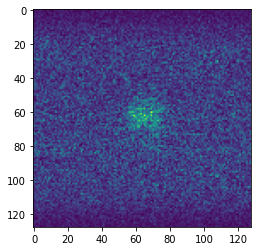

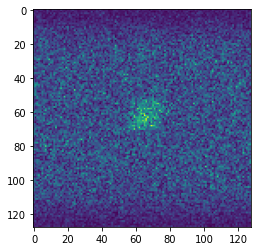

Time taken for epoch:  29.504584789276123
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004749327203039239 Epoch 61
Epoch = [  61/ 250] TrainLoss = 0.002731  DevLoss = 0.004749 TrainTime = 15.4592s DevTime = 13.3682s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


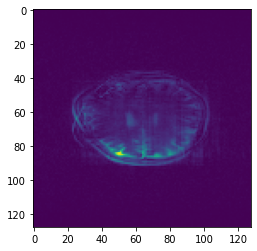

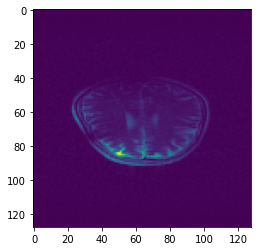

Time taken for epoch:  29.15539574623108
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0050625359876969485 Epoch 62
Epoch = [  62/ 250] TrainLoss = 0.002888  DevLoss = 0.005063 TrainTime = 15.7539s DevTime 

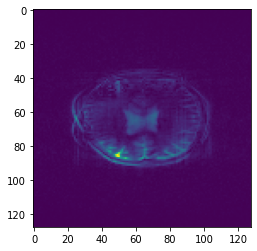

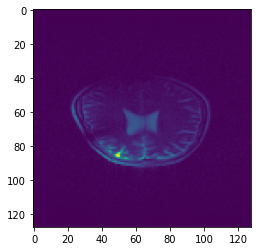

Time taken for epoch:  29.46989154815674
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004063122324554 Epoch 63
Epoch = [  63/ 250] TrainLoss = 0.002812  DevLoss = 0.004063 TrainTime = 15.4484s DevTime = 13.5612s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


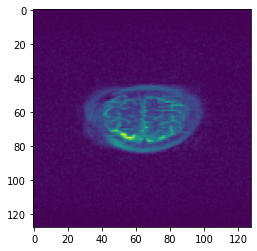

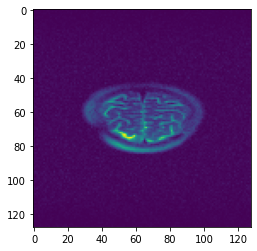

Time taken for epoch:  29.35496234893799
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004412142292727147 Epoch 64
Epoch = [  64/ 250] TrainLoss = 0.00287  DevLoss = 0.004412 TrainTime = 15.5328s DevTime = 13.1939s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


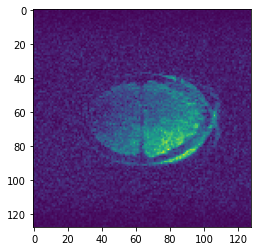

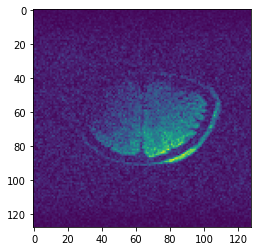

Time taken for epoch:  29.078875303268433
[2, 3]
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2,

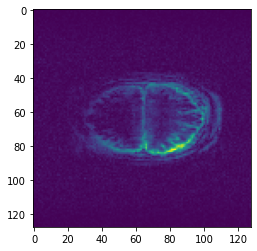

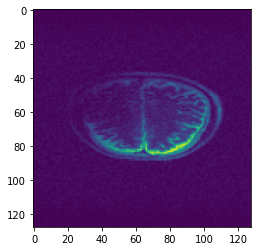

Time taken for epoch:  29.251824378967285
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004130943180929016 Epoch 66
Epoch = [  66/ 250] TrainLoss = 0.002769  DevLoss = 0.004131 TrainTime = 15.3784s DevTime = 13.2938s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


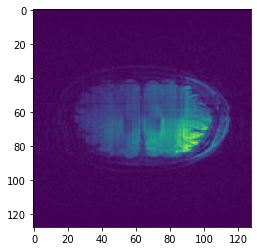

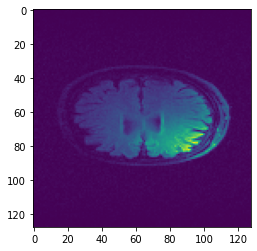

Time taken for epoch:  28.99426770210266
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.003938518805127353 Epoch 67
Epoch = [  67/ 250] TrainLoss = 0.002632  DevLoss = 0.003939 TrainTime = 15.4950s DevTime = 13.3306s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


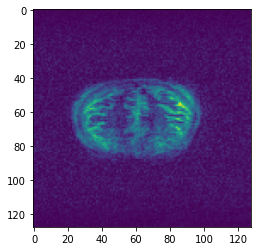

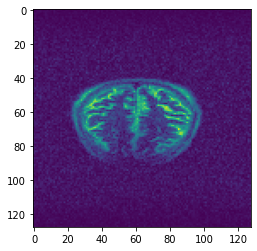

Time taken for epoch:  29.17358160018921
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0042386914166267775 Epoch 68
Epoch = [  68/ 250] TrainLoss = 0.002837  DevLoss = 0.004239 TrainTime = 15.6145s DevTime = 13.4066s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


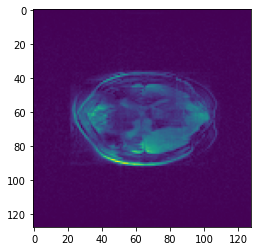

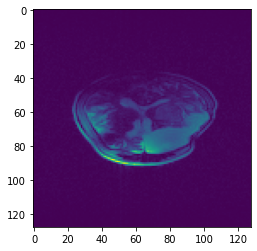

Time taken for epoch:  29.343844175338745
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004884582418131191 Epoch 69
Epoch = [  69/ 250] TrainLoss = 0.002707  DevLoss = 0.004885 TrainTime = 15.3906s DevTime = 13.3133s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


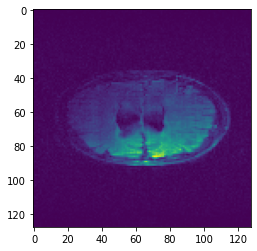

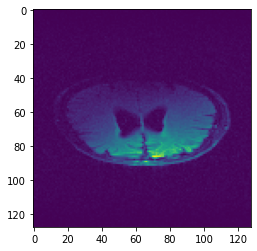

Time taken for epoch:  29.046951293945312
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004586953096224482 Epoch 70
Epoch = [  70/ 250] TrainLoss = 0.002739  DevLoss = 0.004587 TrainTime = 15.4863s DevTime = 13.2191s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


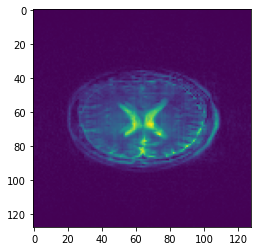

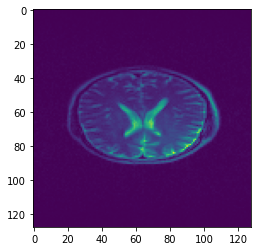

Time taken for epoch:  29.01902461051941
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004210671440587514 Epoch 71
Epoch = [  71/ 250] TrainLoss = 0.002727  DevLoss = 0.004211 TrainTime = 15.5524s DevTime = 13.4613s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


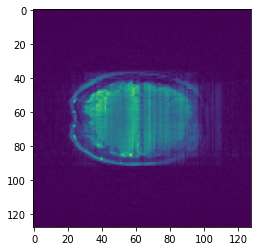

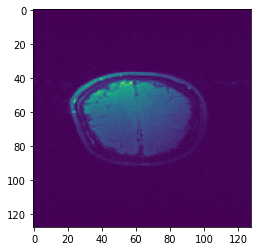

Time taken for epoch:  29.32122778892517
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.003896723789539988 Epoch 72
Epoch = [  72/ 250] TrainLoss = 0.002762  DevLoss = 0.003897 TrainTime = 15.3901s DevTime = 13.3743s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


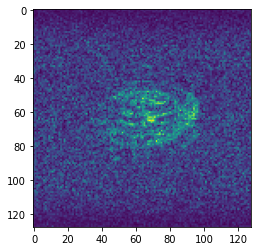

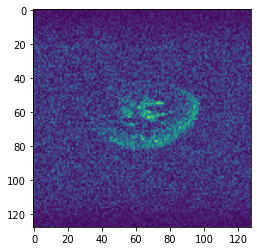

Time taken for epoch:  29.11611557006836
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004416202980583771 Epoch 73
Epoch = [  73/ 250] TrainLoss = 0.002736  DevLoss = 0.004416 TrainTime = 15.3942s DevTime = 13.3940s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


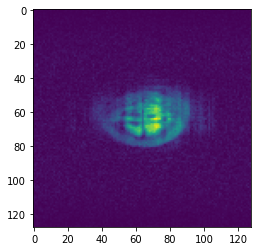

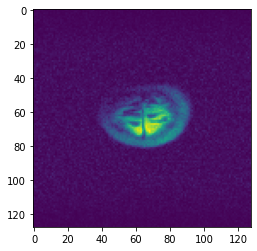

Time taken for epoch:  29.13370156288147
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.00479810307957896 Epoch 74
Epoch = [  74/ 250] TrainLoss = 0.002688  DevLoss = 0.004798 TrainTime = 15.3563s DevTime = 13.1982s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


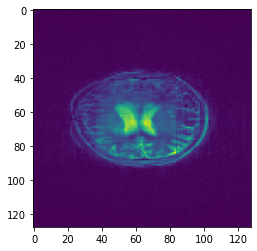

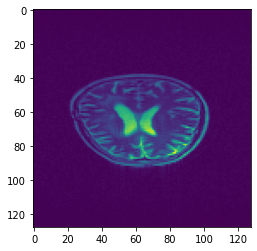

Time taken for epoch:  28.903484344482422
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.00460438379122119 Epoch 75
Epoch = [  75/ 250] TrainLoss = 0.002671  DevLoss = 0.004604 TrainTime = 15.6011s DevTime = 12.9416s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


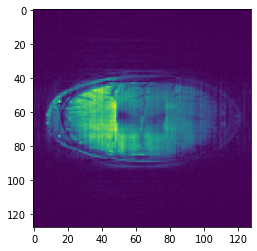

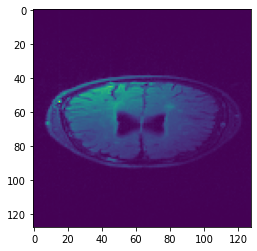

Time taken for epoch:  28.878699779510498
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004494732453010676 Epoch 76
Epoch = [  76/ 250] TrainLoss = 0.002607  DevLoss = 0.004495 TrainTime = 15.4578s DevTime =

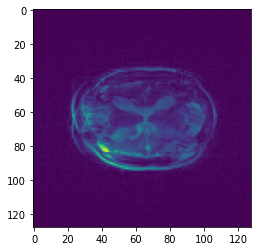

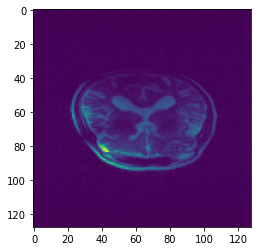

Time taken for epoch:  29.21778440475464
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004300690271565794 Epoch 77
Epoch = [  77/ 250] TrainLoss = 0.002574  DevLoss = 0.004301 TrainTime = 15.4876s DevTime =

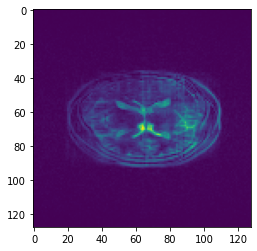

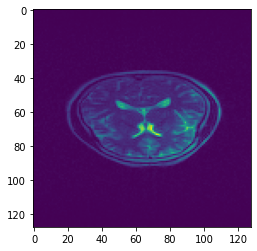

Time taken for epoch:  28.927581310272217
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004866838418679848 Epoch 78
Epoch = [  78/ 250] TrainLoss = 0.002703  DevLoss = 0.004867 TrainTime = 15.6331s DevTime = 13.3748s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


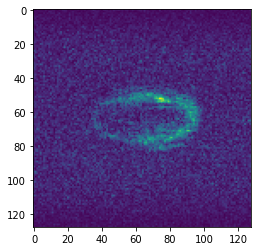

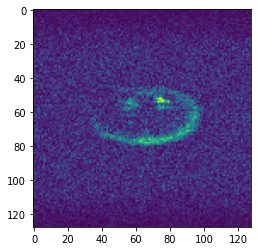

Time taken for epoch:  29.345911026000977
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.006224526294271476 Epoch 79
Epoch = [  79/ 250] TrainLoss = 0.002783  DevLoss = 0.006225 TrainTime = 15.2414s DevTime = 13.6190s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


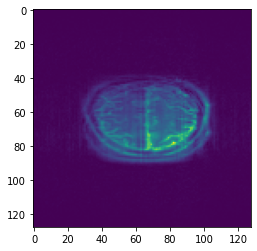

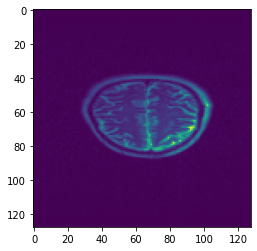

Time taken for epoch:  29.201101064682007
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004254067223066829 Epoch 80
Epoch = [  80/ 250] TrainLoss = 0.002777  DevLoss = 0.004254 T

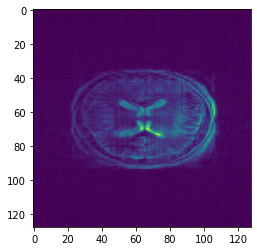

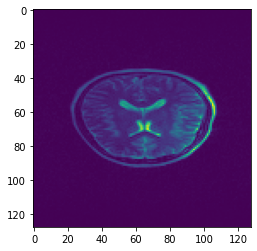

Time taken for epoch:  29.03077244758606
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004921492901367342 Epoch 81
Epoch = [  81/ 250] TrainLoss = 0.002841  DevLoss = 0.004921 TrainTime = 15.6182s DevTime = 13.3981s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


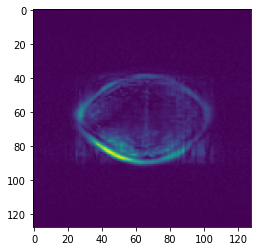

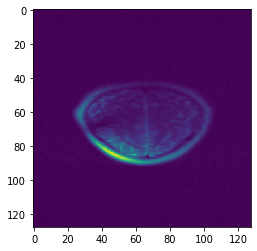

Time taken for epoch:  29.33685064315796
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0046087921124458855 Epoch 82
Epoch = [  82/ 250] TrainLoss = 0.002704  DevLoss = 0.004609 TrainTime = 15.3621s DevTime 

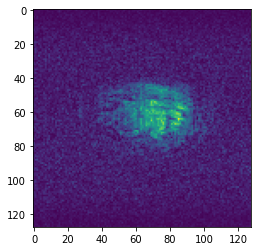

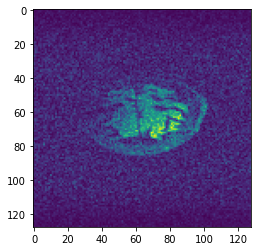

Time taken for epoch:  29.105096101760864
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004307651468977726 Epoch 83
Epoch = [  83/ 250] TrainLoss = 0.002787  DevLoss = 0.004308 T

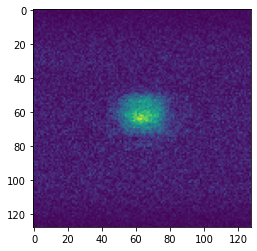

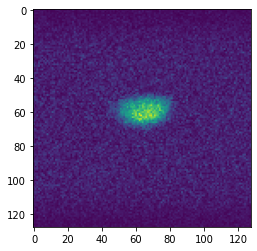

Time taken for epoch:  29.04150700569153
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004640005394768293 Epoch 84
Epoch = [  84/ 250] TrainLoss = 0.002734  DevLoss = 0.00464 TrainTime = 15.4260s DevTime = 12.8748s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


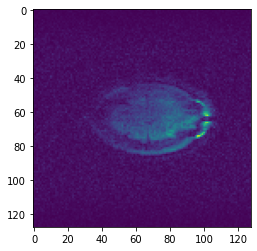

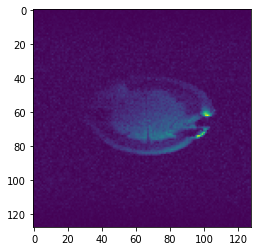

Time taken for epoch:  28.659088611602783
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004043848471206002 Epoch 85
Epoch = [  85/ 250] TrainLoss = 0.002651  DevLoss = 0.004044 TrainTime = 16.7807s DevTime =

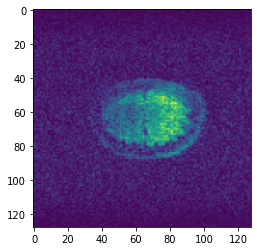

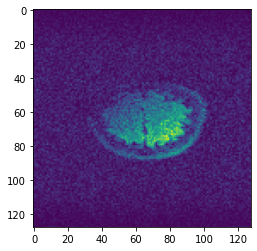

Time taken for epoch:  30.691642999649048
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004098896110100563 Epoch 86
Epoch = [  86/ 250] TrainLoss = 0.002673  DevLoss = 0.004099 TrainTime = 15.8558s DevTime = 14.0783s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


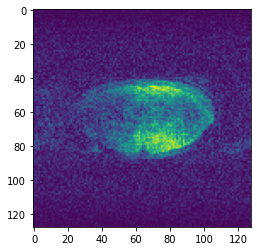

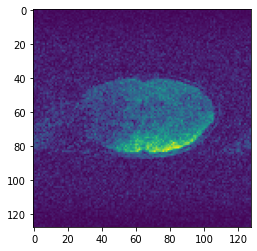

Time taken for epoch:  30.293784618377686
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004302054524048863 Epoch 87
Epoch = [  87/ 250] TrainLoss = 0.002698  DevLoss = 0.004302 TrainTime = 18.2374s DevTime = 14.4546s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 2

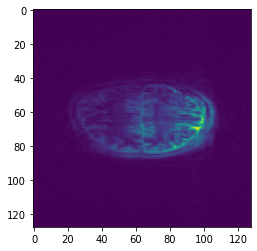

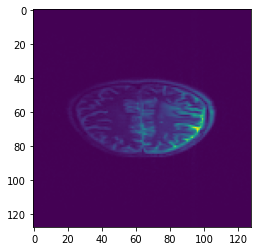

Time taken for epoch:  33.01557922363281
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004328504114903372 Epoch 88
Epoch = [  88/ 250] TrainLoss = 0.002801  DevLoss = 0.004329 TrainTime = 18.2299s DevTime = 14.5863s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


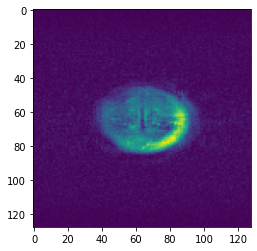

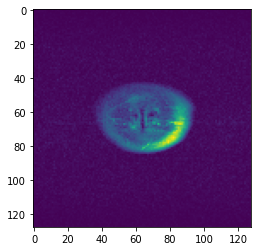

Time taken for epoch:  33.17818856239319
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004146351364785329 Epoch 89
Epoch = [  89/ 250] TrainLoss = 0.002774  DevLoss = 0.004146 TrainTime = 18.1793s DevTime = 14.4706s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


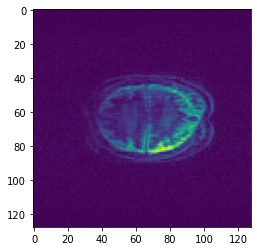

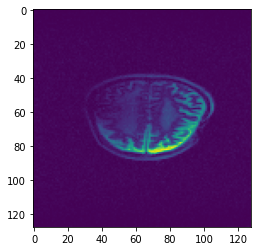

Time taken for epoch:  32.99378991127014
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004258562574935084 Epoch 90
Epoch = [  90/ 250] TrainLoss = 0.002695  DevLoss = 0.004259 TrainTime = 18.1534s DevTime = 14.4747s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


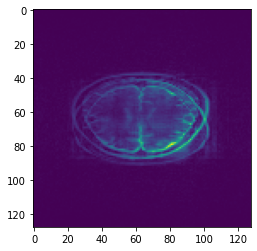

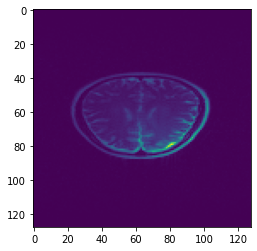

Time taken for epoch:  32.97032618522644
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004169175966956153 Epoch 91
Epoch = [  91/ 250] TrainLoss = 0.002677  DevLoss = 0.004169 TrainTime = 18.1792s DevTime = 14.5504s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


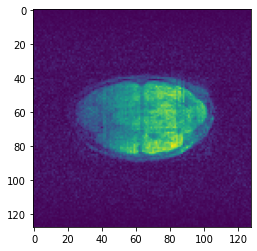

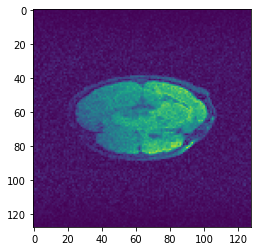

Time taken for epoch:  33.09142088890076
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.00375839040846703 Epoch 92
Epoch = [  92/ 250] TrainLoss = 0.002714  DevLoss = 0.003758 TrainTime = 18.1876s DevTime = 14.5986s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


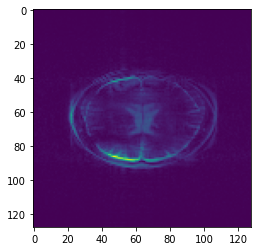

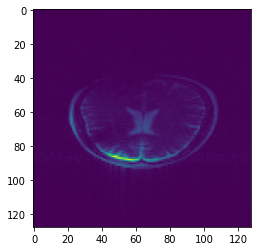

Time taken for epoch:  33.11971664428711
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004148914569164651 Epoch 93
Epoch = [  93/ 250] TrainLoss = 0.002604  DevLoss = 0.004149 TrainTime = 18.1721s DevTime = 14.5822s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


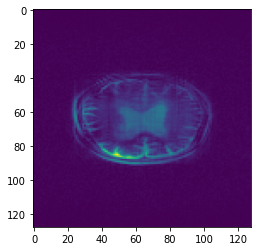

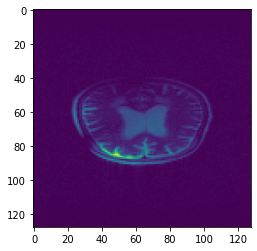

Time taken for epoch:  33.09591221809387
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004097391412778906 Epoch 94
Epoch = [  94/ 250] TrainLoss = 0.002791  DevLoss = 0.004097 TrainTime = 18.2238s DevTime =

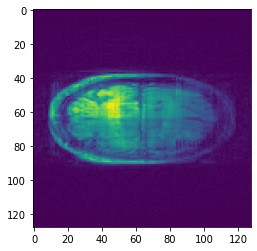

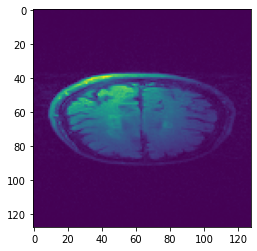

Time taken for epoch:  33.18345785140991
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.005543534738973067 Epoch 95
Epoch = [  95/ 250] TrainLoss = 0.002749  DevLoss = 0.005544 TrainTime = 16.8214s DevTime = 13.3454s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


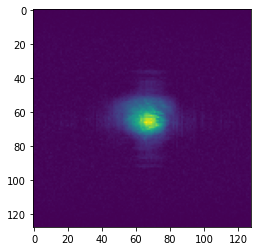

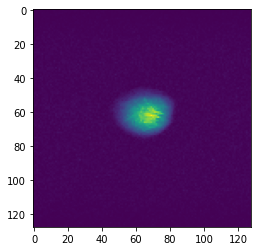

Time taken for epoch:  30.488137006759644
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004171188374814077 Epoch 96
Epoch = [  96/ 250] TrainLoss = 0.002737  DevLoss = 0.004171 TrainTime = 15.4957s DevTime = 13.4868s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


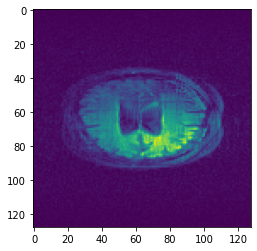

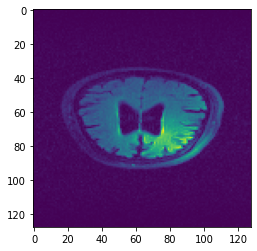

Time taken for epoch:  29.336151123046875
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.004031306749535547 Epoch 97
Epoch = [  97/ 250] TrainLoss = 0.002586  DevLoss = 0.004031 TrainTime = 15.5771s DevTime = 13.1733s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


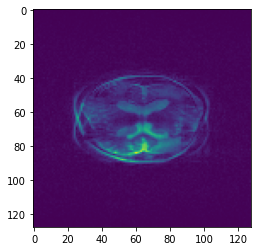

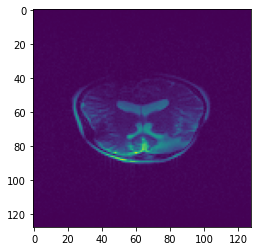

Time taken for epoch:  29.072983741760254
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.003943665416782528 Epoch 98
Epoch = [  98/ 250] TrainLoss = 0.002657  DevLoss = 0.003944 TrainTime = 15.5470s DevTime = 13.4466s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


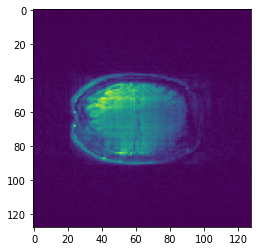

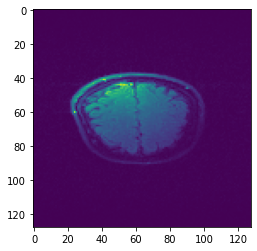

Time taken for epoch:  29.326078414916992
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.003927960805627617 Epoch 99
Epoch = [  99/ 250] TrainLoss = 0.002639  DevLoss = 0.003928 TrainTime = 17.0604s DevTime = 14.5644s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


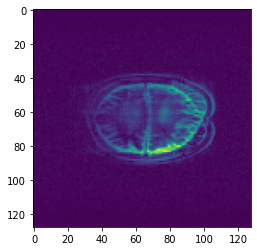

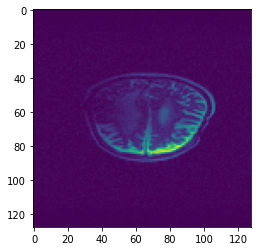

Time taken for epoch:  31.976640224456787
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.003934313241477669 Epoch 100
Epoch = [ 100/ 250] TrainLoss = 0.002576  DevLoss = 0.003934 TrainTime = 18.2637s DevTime = 14.4989s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


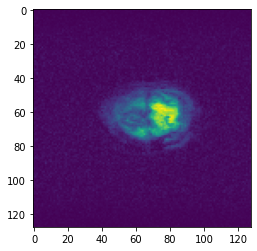

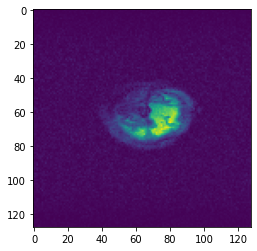

Time taken for epoch:  33.10536336898804
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0038873514655425267 Epoch 101
Epoch = [ 101/ 250] TrainLoss = 0.002536  DevLoss = 0.003887 TrainTime = 18.1515s DevTime = 14.3497s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


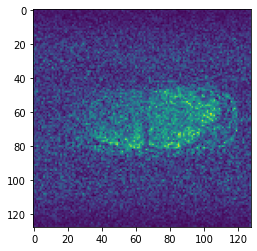

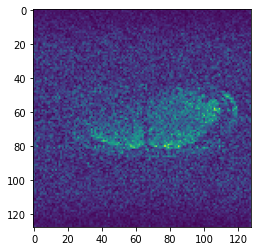

Time taken for epoch:  32.861199617385864
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0039053047507863286 Epoch 102
Epoch = [ 102/ 250] TrainLoss = 0.00248  DevLoss = 0.003905 TrainTime = 18.4174s DevTime = 14.7103s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 

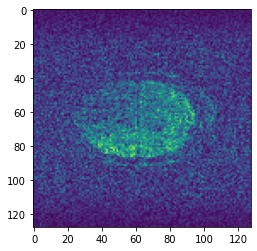

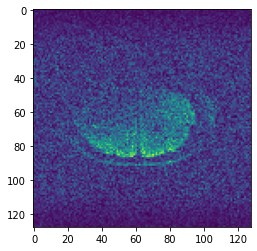

Time taken for epoch:  33.49584627151489
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.003877426171746489 Epoch 103
Epoch = [ 103/ 250] TrainLoss = 0.002505  DevLoss = 0.003877 TrainTime = 18.5850s DevTime = 15.0308s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


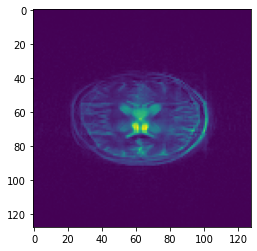

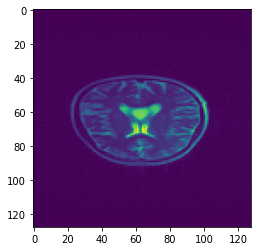

Time taken for epoch:  33.95743775367737
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0039503654474737455 Epoch 104
Epoch = [ 104/ 250] TrainLoss = 0.002536  DevLoss = 0.00395 TrainTime = 18.3268s DevTime = 14.5698s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


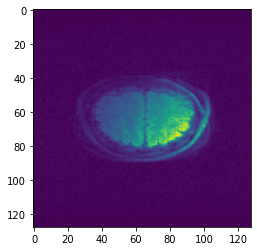

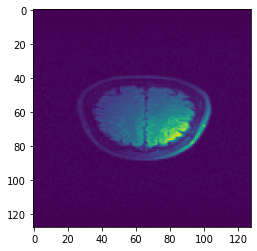

Time taken for epoch:  33.25024914741516
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0038881206216645867 Epoch 105
Epoch = [ 105/ 250] TrainLoss = 0.002498  DevLoss = 0.003888 TrainTime = 18.2373s DevTime

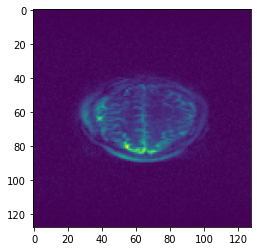

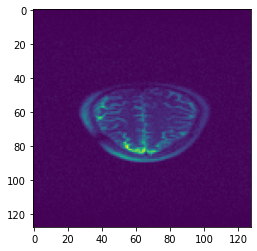

Time taken for epoch:  33.20420265197754
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.003986672457986931 Epoch 106
Epoch = [ 106/ 250] TrainLoss = 0.002483  DevLoss = 0.003987 TrainTime = 18.1648s DevTime = 14.5628s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


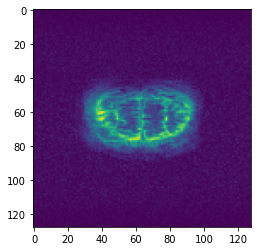

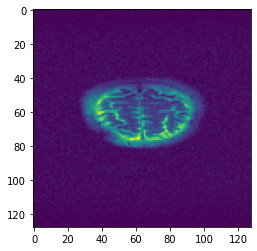

Time taken for epoch:  33.08953332901001
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0039159824273970675 Epoch 107
Epoch = [ 107/ 250] TrainLoss = 0.002536  DevLoss = 0.003916 TrainTime = 18.0873s DevTime = 20.4396s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


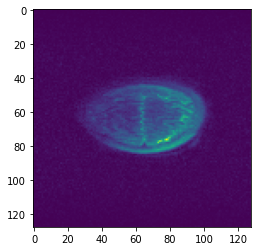

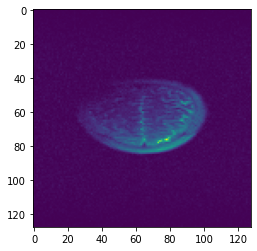

Time taken for epoch:  39.170427083969116
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.003909084402253521 Epoch 108
Epoch = [ 108/ 250] TrainLoss = 

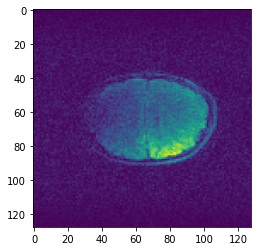

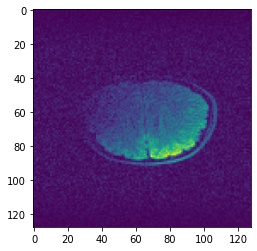

Time taken for epoch:  85.22371315956116
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0038709632298230745 Epoch 109
Epoch = [ 109/ 250] TrainLoss =

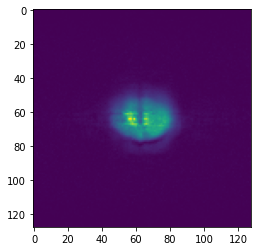

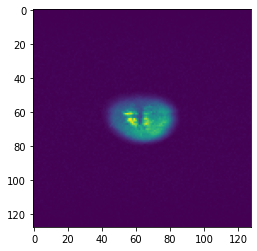

Time taken for epoch:  71.6455557346344
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 25

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0038948199263553807 Epoch 110
Epoch = [ 110/ 250] TrainLoss = 0.002475  DevLoss = 0.003895 TrainTime = 25.6444s DevTime = 23.0316s
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])



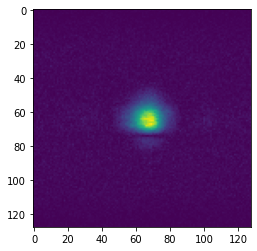

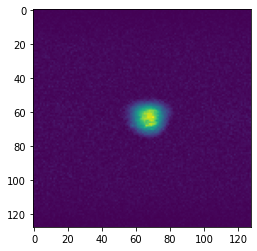

Time taken for epoch:  50.79309129714966
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.003912469319307948 Epoch 111
Epoch = [ 111/ 250] TrainLoss = 0.002476  DevLoss = 0.003912 TrainTime = 35.0938s DevTime = 6.1600s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


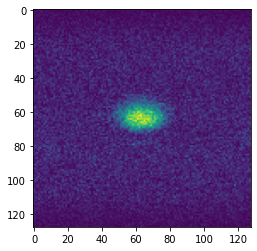

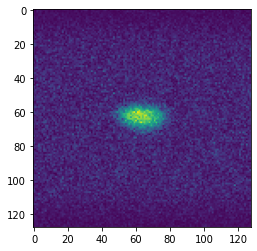

Time taken for epoch:  43.20276355743408
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.003

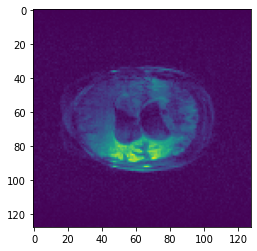

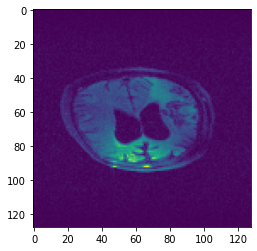

Time taken for epoch:  77.1812732219696
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 25

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

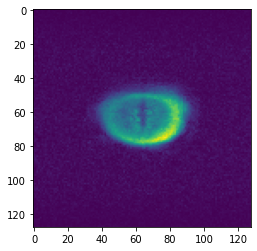

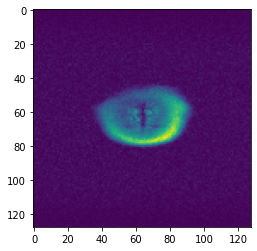

Time taken for epoch:  64.72372245788574
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])torch.Size([2, 1, 256, 256])

Dev_Loss 0.003

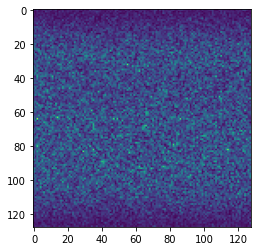

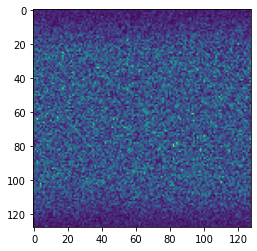

Time taken for epoch:  55.45953321456909
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])torch.Size([2, 1, 256, 256])

Dev_Loss 0.0039052179562771255 Epoch 115
Epoch = [ 115/ 250] TrainLoss = 0.002474  DevLoss = 0.003905 TrainTime = 19.9431s DevTime = 15.3513s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


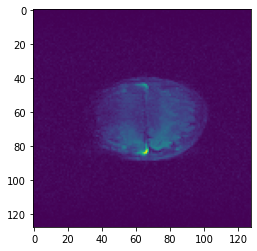

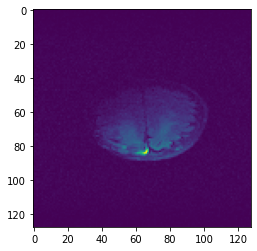

Time taken for epoch:  35.721877574920654
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])torch.Size([4, 1, 256, 256])

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.003952157822126733 Epoch 116
Epoch = [ 116/ 250] TrainLoss = 0.002502  DevLoss = 0.003952 TrainTime = 20.1001s DevTime = 13.5772s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


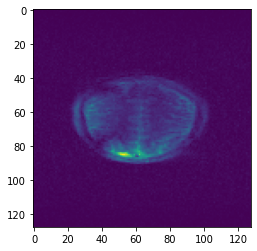

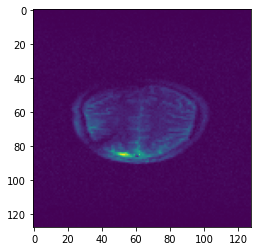

Time taken for epoch:  34.013071060180664
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.0040428785662029445 Epoch 117
Epoch = [ 117/ 250] TrainLoss = 0.00257  DevLoss = 0.004043 TrainTime = 14.5272s DevTime = 11.8578s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


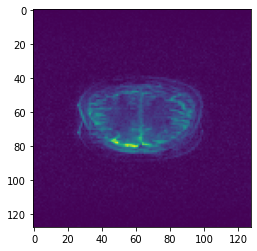

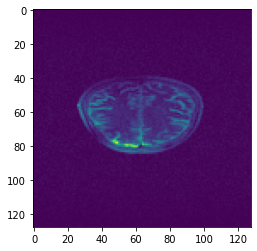

Time taken for epoch:  26.726322889328003
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.003868401530893758 Epoch 118
Epoch = [ 118/ 250] TrainLoss = 0.002539  DevLoss = 0.003868 TrainTime = 14.5366s DevTime = 11.9799s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


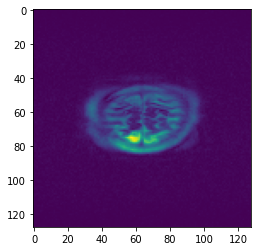

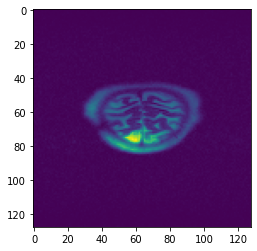

Time taken for epoch:  26.848528146743774
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([2, 1, 256, 256])
torch.Size([2, 1, 256, 256])
Dev_Loss 0.003966745805514477 Epoch 119
Epoch = [ 119/ 250] TrainLoss = 0.002369  DevLoss = 0.003967 TrainTime = 14.3037s DevTime = 11.8142s
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])


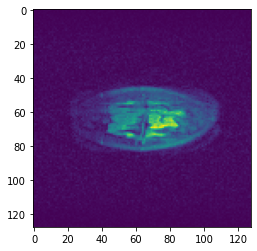

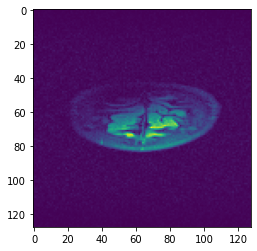

Time taken for epoch:  26.44673204421997
[2, 3]
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 2

torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4, 1, 256, 256])
torch.Size([4,

In [ ]:
#compare, contrast

human_readable="ComplexEndToEnd_Kspace_FourierTransform_Compare-Real"
args.exp_dir=Path('/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_'+str(human_readable))
args.checkpoint='/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_'+str(human_readable)+'/best_model.pt'
args.logdir='/mnt/mnt/5TB_slot2/Tobias/Thesis/log/ff_lrelu_'+str(human_readable)
def build_model(args,chans=args.num_chans,num_pool_layers=args.num_pools,drop_prob=0.05):
    #check every time which gpus are available!
    #device_ids=[2,3,1]
    torch.cuda.empty_cache()
    device_ids=args.device_ids
    model=td_fourier_net_real(in_chans=1,out_chans=1,drop_prob=args.drop_prob,resolution=args.resolution).to(f'{args.device}:{device_ids[0]}')
    model=model.double()
    if args.data_parallel and args.device=="cuda":
        model = nn.DataParallel(model,device_ids=device_ids)
    print("Model build successfully")
    #vis_weights(model)
    return model

train(args)

In [21]:
#f ="/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelue_2020/best_model.pt"
checkpoint, model, optimizer = load_model(args.checkpoint,args)
model.eval()

Model build successfully
Model load successfully


DataParallel(
  (module): td_fourier_net_real(
    (c_layer1): Conv2d(1, 256, kernel_size=(1, 256), stride=(1, 1), bias=False)
    (c_layer2): Conv2d(1, 128, kernel_size=(1, 128), stride=(1, 1), bias=False)
  )
)

module.c_layer1.weight tensor([[[[-0.0065, -0.0010,  0.0074,  ..., -0.0020,  0.0066,  0.0005]]],


        [[[-0.0055,  0.0019,  0.0075,  ...,  0.0004,  0.0074, -0.0017]]],


        [[[-0.0054,  0.0048,  0.0067,  ...,  0.0028,  0.0059, -0.0027]]],


        ...,


        [[[ 0.0004,  0.0073,  0.0030,  ...,  0.0078,  0.0004, -0.0075]]],


        [[[-0.0002, -0.0064, -0.0008,  ..., -0.0067, -0.0001,  0.0062]]],


        [[[-0.0036, -0.0057,  0.0013,  ..., -0.0060,  0.0031,  0.0054]]]],
       device='cuda:2', dtype=torch.float64)


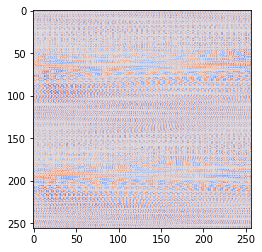

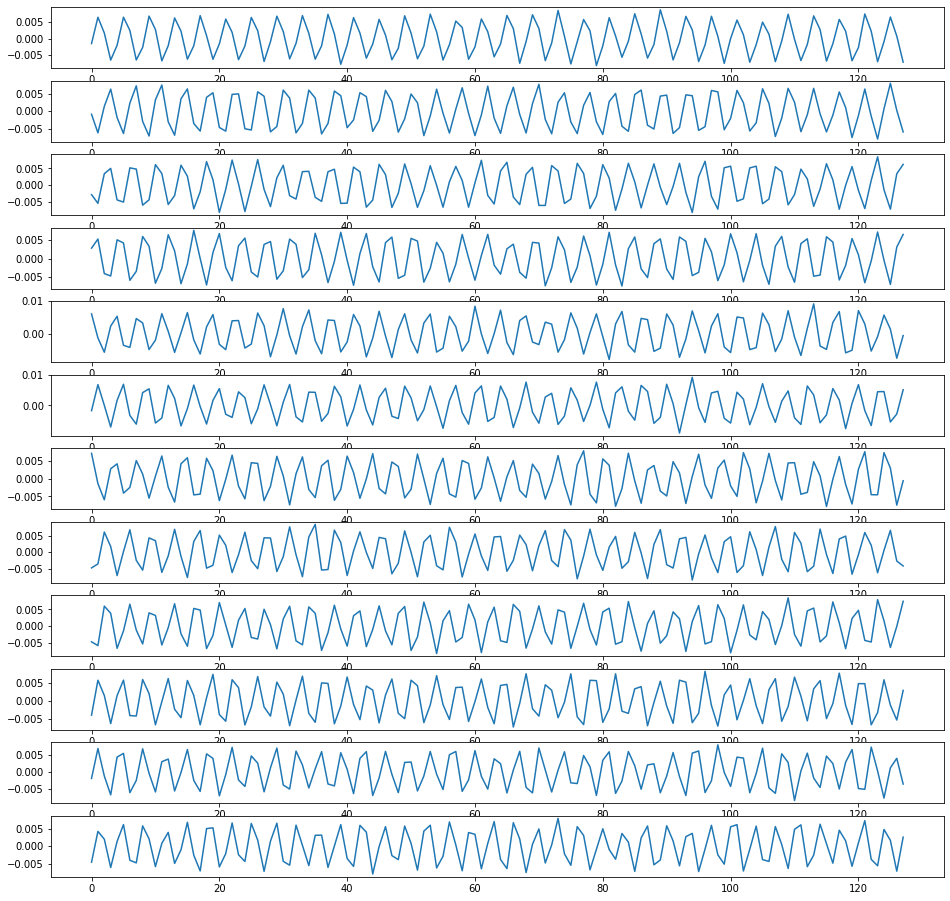

module.c_layer2.weight tensor([[[[ 0.0089, -0.0088,  0.0087,  ..., -0.0088,  0.0088, -0.0088]]],


        [[[ 0.0102, -0.0109,  0.0104,  ..., -0.0097,  0.0103, -0.0104]]],


        [[[ 0.0102, -0.0101,  0.0106,  ..., -0.0076,  0.0088, -0.0088]]],


        ...,


        [[[-0.0106,  0.0112, -0.0113,  ...,  0.0091, -0.0093,  0.0099]]],


        [[[-0.0059,  0.0069, -0.0077,  ...,  0.0030, -0.0039,  0.0046]]],


        [[[-0.0104,  0.0107, -0.0111,  ...,  0.0110, -0.0113,  0.0109]]]],
       device='cuda:2', dtype=torch.float64)


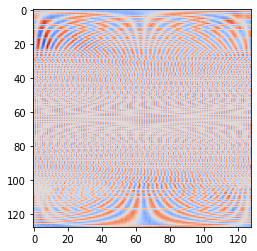

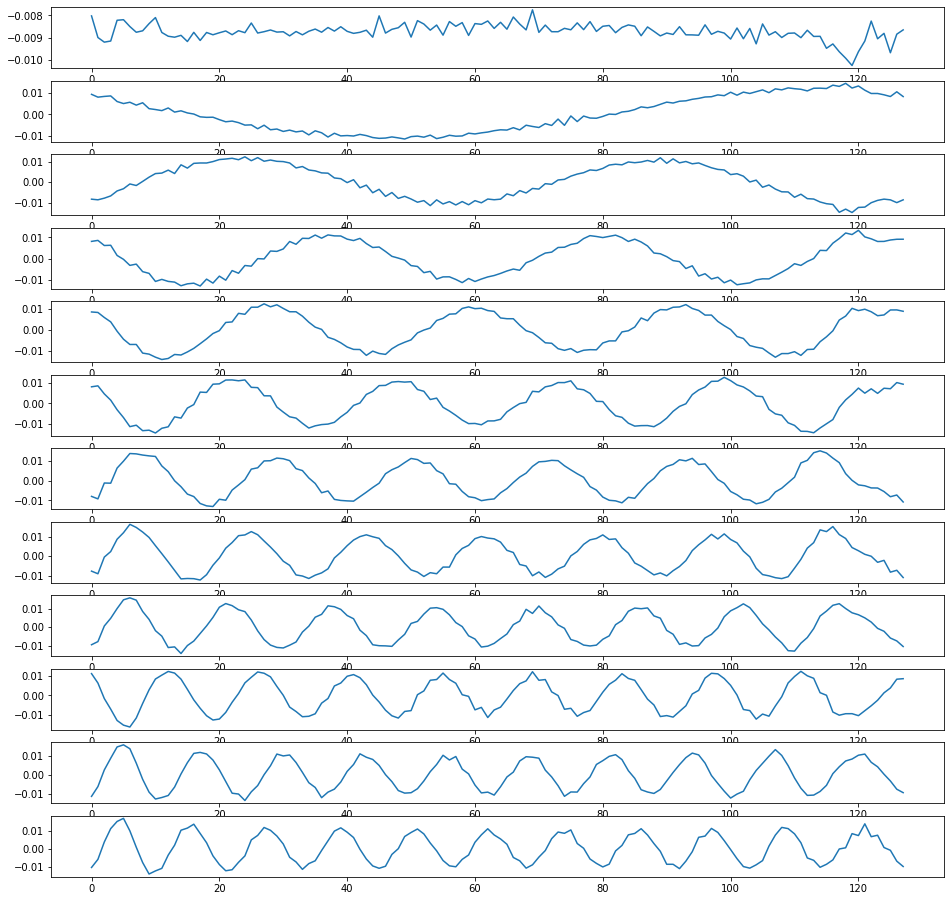

In [22]:
for name, param in model.named_parameters():
    if param.requires_grad:
        print(name, param.data)
        #plt.imshow(nf.ifftshift(param.data.cpu()[:,0,0,:]), vmin=-1, vmax=1, cmap='coolwarm')
        # Heat map of neuron weights
        weights=nf.ifftshift(param.data.cpu()[:,0,0,:])
        np.save(name+'.npy', param.data.cpu())
        plt.imshow(weights, vmin=np.min(param.data.cpu().numpy()), vmax=np.max(param.data.cpu().numpy()), cmap='coolwarm')
        plt.show()
        fig,ax=plt.subplots(args.resolution//10,1,figsize=(16,16))
        for i in range(args.resolution//10):
            ax[i].plot(weights[i,:args.resolution])
        plt.show()

In [ ]:
def train_plain(args): 
    args.exp_dir.mkdir(parents=True, exist_ok=True)
    writer = SummaryWriter(logdir=str(args.logdir)) #log directory for run
    if args.resume: #be aware of the option
        checkpoint, model, optimizer = load_model(args.checkpoint,args)
        args = checkpoint['args']
        best_dev_loss = checkpoint['best_dev_loss']
        #start_epoch = checkpoint['epoch']
        start_epoch = 0
        del checkpoint
    else:
        model = build_model(args)
        optimizer = build_optim(args, model.parameters())
        best_dev_loss = 1e9
        start_epoch = 0
    #train_loader,dev_loader,test_loader = create_data_loaders()
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, args.lr_step_size, args.lr_gamma)
    optimizer.step()

    for epoch in range(start_epoch, args.num_epochs):
        ti=time.time()
        scheduler.step(epoch)
        train_loss, train_time = train_epoch(args, epoch, model, train_loader, optimizer, writer)
        dev_loss, dev_time = evaluate(args, epoch, model, dev_loader, writer)
        #visualize(args, epoch, model, train_loader, writer)

#         is_new_best = dev_loss < best_dev_loss
#         best_dev_loss = min(best_dev_loss, dev_loss)
#         save_model(args, args.exp_dir, epoch, model, optimizer, best_dev_loss, is_new_best)
    writer.close()
    return dev_loss

def run_model(lr):
    print(lr)
    args.lr=lr
    return train_plain(args)

In [ ]:
from hyperopt import hp, tpe, fmin

# Single line bayesian optimization of polynomial function
args.num_epochs=100
best = fmin(fn=lambda x: run_model(x),
            space=hp.normal('x', 0.0001, 0.5),
            algo=tpe.suggest,
            max_evals=100)

In [ ]:
print(best)

In [30]:
c=args.checkpoint#"/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_pure_inverse_fourier/best_model.pt
print(c)
#c='/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_ComplexEndToEnd'+'/model.pt'
checkpoint, model, optimizer = load_model(c,args)
model.eval()
losses=[]
for iter, data in enumerate(train_loader):
            f, t = data
            #plt.hist(f[abs(f) >= 0.00001].flatten(),bins=1000)
            #plt.show()
            #plt.imshow(abs(nu.make_ift(nu.to_complex(f)))[0,0,:,:])
            #plt.show()
            
            input = f.to(f'{args.device}:{model.device_ids[0]}')
            target = t.to(f'{args.device}:{model.device_ids[0]}')
            
            output_r,output_i = model(input)
            l=eval_loss((output_r.squeeze(1)**2+output_i.squeeze(1)**2)**(1/2),target)
            losses.append(l)
            output_r=output_r.to('cpu').detach().numpy()
            output_i=output_i.to('cpu').detach().numpy()
            output = output_r+output_i*1j
            image = abs(output.squeeze(1))
            #print(output)
            #plt.imshow(image[0,:,:])
            #plt.show()

            #plt.imshow(target[0,:,:].to('cpu').detach().numpy())
            #plt.show()
            #break;
losses=np.array(losses)
print(np.mean(losses[:,0]),np.mean(losses[:,1]),np.mean(losses[:,2]),np.min(losses[:,0]),np.max(losses[:,0]),np.min(losses[:,1]),np.max(losses[:,1]),np.min(losses[:,2]),np.max(losses[:,2]))

/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_ComplexEndToEnd_Kspace_FourierTransform_Compare-Complex/best_model.pt
Model build successfully
Model load successfully
torch.Size([2, 128, 128]) torch.Size([2, 128, 128])
2.5618713051347947e-06 7.463834982772139e-11 0.9999999969708674 6.340697697111932e-07 6.7249382132273845e-06 1.8806625062320955e-12 3.9516654708566644e-10 0.9999999911719853 0.9999999997933424


In [20]:
#compare, contrast

human_readable="ComplexEndToEnd_Kspace_FourierTransform_Compare-Real"
args.exp_dir=Path('/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_'+str(human_readable))
args.checkpoint='/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_'+str(human_readable)+'/best_model.pt'
args.logdir='/mnt/mnt/5TB_slot2/Tobias/Thesis/log/ff_lrelu_'+str(human_readable)
c=args.checkpoint#"/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_pure_inverse_fourier/best_model.pt
print(c)
#c='/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_ComplexEndToEnd'+'/model.pt'
checkpoint, model, optimizer = load_model(c,args)
model.eval()
losses=[]
for iter, data in enumerate(train_loader):
            f, t = data
            #plt.hist(f[abs(f) >= 0.00001].flatten(),bins=1000)
            #plt.show()
            #plt.imshow(abs(nu.make_ift(nu.to_complex(f)))[0,0,:,:])
            #plt.show()
            
            input = f.to(f'{args.device}:{model.device_ids[0]}')
            target = t.to(f'{args.device}:{model.device_ids[0]}')
            
            output_r,output_i = model(input)
            l=eval_loss((output_r.squeeze(1)**2+output_i.squeeze(1)**2)**(1/2),target)
            losses.append(l)
            output_r=output_r.to('cpu').detach().numpy()
            output_i=output_i.to('cpu').detach().numpy()
            output = output_r+output_i*1j
            image = abs(output.squeeze(1))
            #print(output)
            #plt.imshow(image[0,:,:])
            #plt.show()

            #plt.imshow(target[0,:,:].to('cpu').detach().numpy())
            #plt.show()
            #break;
losses=np.array(losses)
print(np.mean(losses[:,0]),np.mean(losses[:,1]),np.mean(losses[:,2]),np.min(losses[:,0]),np.max(losses[:,0]),np.min(losses[:,1]),np.max(losses[:,1]),np.min(losses[:,2]),np.max(losses[:,2]))

/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_ComplexEndToEnd_Kspace_FourierTransform_Compare-Real/best_model.pt
Model build successfully
Model load successfully
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
t

torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])torch.Size([4, 1, 128, 256])

torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([8, 128, 128]) torch.Size([8, 128, 128])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 

torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])torch.Size([4, 256, 128, 1])

torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])torch.Size([4, 256, 128, 1])

torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])torch.Size([4, 256, 128, 1])

torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])torch.Size([4, 256, 128, 1])

torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])torch.Size([4, 256, 128, 1])

torch.Size([4,

torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 256, 128, 1])

torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])torch.Size([4, 256, 128, 1])

torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4,

torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])torch.Size([4, 256, 128, 1])

torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])torch.Size([4, 256, 128, 1])

torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])torch.Size([4, 256, 128, 1])

torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])torch.Size([4, 256, 128, 1])

torch.Size([4,

torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 256, 128, 1])torch.Size([4, 1, 128, 256])

torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])torch.Size([4, 256, 128, 1])

torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])torch.Size([4, 256, 128, 1])

torch.Size([4,

torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])torch.Size([4, 256, 128, 1])

torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])
torch.Size([4, 256, 128, 1])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])
torch.Size([4, 1, 128, 256])torch.Size([4, 1, 128, 256])

torch.Size([4, 256, 128, 1])
torch.Size([4, 256, 128, 1])
torch.Size([4,